In [2]:
# plot PCAs RMSDs of AF10K simulations

import os 

import MDAnalysis as mda
import numpy as np






/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
BPTI_top_path = "/home/alexi/Documents/ValDX/raw_data/HDXer_tutorial/BPTI/BPTI_simulations/P00974_60_1_af_sample_127_10000_protonated.pdb"
BPTI_traj_path = "/home/alexi/Documents/ValDX/raw_data/HDXer_tutorial/BPTI/BPTI_simulations/P00974_60_1_af_sample_127_10000_protonated.xtc"
BPTI_json_path = "/home/alexi/Documents/ValDX/raw_data/HDXer_tutorial/BPTI/BPTI_simulations/P00974_60_1_af_sample_127_10000_ranks.json"
BPTI_segs_path = "/home/alexi/Documents/ValDX/raw_data/HDXer_tutorial/BPTI/BPTI_expt_data/BPTI_residue_segs.txt"
BPTI_num_residues = 58


BRD4_top_path = "/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO_484_1_af_sample_127_10000_protonated.pdb"
BRD4_traj_path = "/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO_484_1_af_sample_127_10000_protonated.xtc"
BRD4_json_path = "/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO_484_1_af_sample_127_10000_ranks.json"
BRD4_segs_path = "/home/alexi/Documents/ValDX/raw_data/BRD4/BRD4_APO/BRD4_APO_segs.txt"
BRD4_num_residues = 484

HOIP_top_path = "/home/alexi/Documents/ValDX/raw_data/HOIP/HOIP_apo/HOIP_apo697_1_af_sample_127_10000_protonated.pdb"
HOIP_traj_path = "/home/alexi/Documents/ValDX/raw_data/HOIP/HOIP_apo/HOIP_apo697_1_af_sample_127_10000_protonated.xtc"
HOIP_json_path = "/home/alexi/Documents/ValDX/raw_data/HOIP/HOIP_apo/HOIP_apo697_1_af_sample_127_10000_ranks.json"
HOIP_segs_path = "/home/alexi/Documents/ValDX/raw_data/HOIP/HOIP_apo/HOIP_APO_segs.txt"
HOIP_num_residues = 376

LXR_top_path = "/home/alexi/Documents/ValDX/raw_data/LXRalpha/LXRalpha_APO/LXRa200_1_af_sample_127_10000_protonated.pdb"
LXR_traj_path = "/home/alexi/Documents/ValDX/raw_data/LXRalpha/LXRalpha_APO/LXRa200_1_af_sample_127_10000_protonated.xtc"
LXR_json_path = "/home/alexi/Documents/ValDX/raw_data/LXRalpha/LXRalpha_APO/LXRa200_1_af_sample_127_10000_ranks.json"
LXR_segs_path = "/home/alexi/Documents/ValDX/raw_data/LXRalpha/LXRalpha_APO/LXRa_APO_segs200.txt"
LXR_num_residues = 250


MBP_top_path = "/home/alexi/Documents/ValDX/raw_data/MBP/MBP_wt_1_af_sample_127_10000_protonated.pdb"
MBP_traj_path = "/home/alexi/Documents/ValDX/raw_data/MBP/MBP_wt_1_af_sample_127_10000_protonated.xtc" 
MBP_json_path = "/home/alexi/Documents/ValDX/raw_data/MBP/MBP_wt_1_af_sample_127_10000_ranks.json"
MBP_segs_path = "/home/alexi/Documents/ValDX/raw_data/MBP/MaltoseBindingProtein/MBP_wt1_segs.txt"
MBP_num_residues = 396


protein_names = ["BPTI", "BRD4", "HOIP", "LXR", "MBP"]



proteins = {"BPTI": {"top": BPTI_top_path, "traj": BPTI_traj_path, "json": BPTI_json_path, "num_residues": BPTI_num_residues, "segs_path":BPTI_segs_path},
            "BRD4": {"top": BRD4_top_path, "traj": BRD4_traj_path, "json": BRD4_json_path, "num_residues": BRD4_num_residues, "segs_path":BRD4_segs_path},
            "HOIP": {"top": HOIP_top_path, "traj": HOIP_traj_path, "json": HOIP_json_path, "num_residues": HOIP_num_residues, "segs_path":HOIP_segs_path},
            "LXR": {"top": LXR_top_path, "traj": LXR_traj_path, "json": LXR_json_path, "num_residues": LXR_num_residues, "segs_path":LXR_segs_path},
            "MBP": {"top": MBP_top_path, "traj": MBP_traj_path, "json": MBP_json_path, "num_residues": MBP_num_residues, "segs_path":MBP_segs_path}}


In [4]:
import json

def load_json(json_path):
    with open(json_path, 'r') as f:
        data = json.load(f)
    return data


json_data = {protein: load_json(proteins[protein]["json"]) for protein in protein_names}


from typing import Dict

def extract_val_json(protein_data: Dict, key: str="plddt")->np.array:

    val_data = []
    for msa, run in protein_data.items():
        for rank, data in run.items():
            if key in data:
                val_data.append(data[key])

    return np.array(val_data)

plddt_data = {protein: extract_val_json(json_data[protein]) for protein in protein_names}

max_pae_data = {protein: extract_val_json(json_data[protein], key='max_pae') for protein in protein_names}

ptm_data = {protein: extract_val_json(json_data[protein], key='ptm') for protein in protein_names}



In [5]:
print(plddt_data["BPTI"])

[95.92 95.69 96.3  ... 71.53 83.01 84.33]


In [6]:

import sys
sys.path.append("/home/alexi/Documents/ValDX/")


In [7]:
from ValDX.VDX_dataclasses import Segments

/home/alexi/Documents/interpretable-hdxer/notebooks/Figure-5_RW_Cluster_size


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/Bio/Application/__init__.py:40: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


In [8]:
segs_data = {protein:Segments(segs_path=proteins[protein]["segs_path"]) for protein in proteins}


Segments class created with 41 peptides
Resnumbers calculated for 41 segments
Resnumbers calculated for 41 segments
Residues calculated for 50 segments
Resnumbers calculated for 41 segments
Peptides calculated for 41 segments
Calculating residue centrality
Resnumbers calculated for 41 segments
Calculating peptide centrality
Resnumbers calculated for 41 segments
Peptides calculated for 41 segments
Calculating residue centrality
Resnumbers calculated for 41 segments
Peptide centrality calculated for 41 peptides
Segments class created with 103 peptides
Resnumbers calculated for 103 segments
Resnumbers calculated for 103 segments
Residues calculated for 282 segments
Resnumbers calculated for 103 segments
Peptides calculated for 103 segments
Calculating residue centrality
Resnumbers calculated for 103 segments
Calculating peptide centrality
Resnumbers calculated for 103 segments
Peptides calculated for 103 segments
Calculating residue centrality
Resnumbers calculated for 103 segments
Peptid

In [9]:


res_data = {protein:segs_data[protein].residues for protein in proteins}
print(res_data)

{'BPTI': array([ 4,  5,  6,  7,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
       22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38,
       40, 41, 42, 43, 44, 45, 46, 47, 48, 50, 51, 52, 53, 54, 55, 56]), 'BRD4': array([  5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,
        18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  29,  30,
        31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,  42,  43,
        44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,
        57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,
        70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,
        83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,
        96,  97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108,
       109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121,
       122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134,
       135, 136, 137, 138, 139, 140, 141

In [10]:
# calculate RMSD of each frame in trajectory to the first frame
import pandas as pd

from MDAnalysis.analysis import rms

def calculate_rmsd(universe:mda.Universe, residues:list=None, ref_frame_index:int=0):
    

    sel = "protein and name CA"

    if residues is not None:
        resi_sel = " or".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"


    universe.trajectory[ref_frame_index]

    ref = universe.select_atoms(sel)
    
    rmsd = rms.RMSD(universe, ref, select=sel)
    rmsd.run()
    
    return rmsd.results.rmsd[:, 2]


RMSD_df = pd.DataFrame()

for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    rmsd = calculate_rmsd(universe, residues=residues, ref_frame_index=ref_index)
    
    df_to_add = pd.DataFrame({"protein": protein, "RMSD": [rmsd]})

    RMSD_df = pd.concat([RMSD_df, df_to_add], axis=0)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


In [11]:
#import pdist
from scipy.spatial.distance import pdist
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_dist(universe, residues:list=None, ref_frame_index:int=0):
    
    """after aligning the traj in memory 
    we calculate the sum of the distances 
    between the atoms of each residue for each frame"""

    sel = "protein and name CA"

    if residues is not None:
        resi_sel = " or".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"


    universe.trajectory[ref_frame_index]

    ref = universe.select_atoms(sel)
    # ref = universe.select_atoms("protein and name CA")
    # Align the trajectory to the reference structure
    alignment = mda.analysis.align.AlignTraj(universe, ref, select=sel, in_memory=True).run()
    
    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)

    # calculate the intrares distances of atomgroup for each frame

    calc_intra_residue_dist = np.zeros((n_frames, n_residues*(n_residues-1)//2))
    # coords = np.zeros((n_frames, n_residues, 3))
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions

        calc_intra_residue_dist[i] = pdist(coords)
 

    print(calc_intra_residue_dist.shape)

    # average the distances for each frame
    avg_intra_residue_dist = np.mean(calc_intra_residue_dist, axis=1)

    return avg_intra_residue_dist


intra_residue_dist_df = pd.DataFrame()

for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]

    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_dist = calc_intra_residue_dist(universe, residues=residues, ref_frame_index=ref_index)
    
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_dist": [intra_residue_dist]})

    intra_residue_dist_df = pd.concat([intra_residue_dist_df, df_to_add], axis=0)
    

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


(12700, 1225)
(12700, 39621)
(12700, 47895)
(12700, 24090)
(12700, 62481)


In [12]:
# import numpy as np
# from scipy.spatial.distance import pdist, squareform
# from MDAnalysis.analysis.align import AlignTraj

# def calc_intra_residue_det(universe):
#     """
#     After aligning the trajectory in memory, calculate the determinant
#     of the intra-residue distance matrix for each frame.
#     """
#     ref = universe.select_atoms("protein and name CA")
    
#     # Align the trajectory to the reference structure
#     alignment = mda.analysis.align.AlignTraj(universe, ref, select="protein and name CA", in_memory=True).run()
    
#     n_frames = len(universe.trajectory)
#     n_residues = len(ref.residues)
    
#     # Calculate the determinant of the intra-residue distance matrix for each frame
#     intra_residue_det = np.zeros(n_frames)
    
#     for i, ts in enumerate(universe.trajectory):
#         coords = ref.positions
#         dist_matrix = squareform(pdist(coords))
#         intra_residue_det[i] = np.linalg.det(dist_matrix)
    
#     return intra_residue_det

# intra_residue_det_df = pd.DataFrame()

# for protein in protein_names:
#     universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
#     intra_residue_det = calc_intra_residue_det(universe)
#     df_to_add = pd.DataFrame({"protein": protein, "intra_residue_det": [intra_residue_det]})
#     intra_residue_det_df = pd.concat([intra_residue_det_df, df_to_add], axis=0)

In [13]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_covariance(universe, residues:list=None, ref_frame_index:int=0):


    """
    After aligning the trajectory in memory, calculate the covariance
    of the intra-residue distances of each frame to the reference frame.
    """
    

    sel = "protein and name CA"

    if residues is not None:
        resi_sel = " or".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"


    universe.trajectory[ref_frame_index]

    ref = universe.select_atoms(sel)
    # ref = universe.select_atoms("protein and name CA")
    # Align the trajectory to the reference structure
    alignment = mda.analysis.align.AlignTraj(universe, ref, select=sel, in_memory=True).run()
    
    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)
    
    # Calculate the intra-residue distance matrix for the reference frame
    ref_coords = ref.positions
    ref_dist_matrix = squareform(pdist(ref_coords))
    
    # Calculate the covariance of the intra-residue distances for each frame
    intra_residue_covariance = np.zeros(n_frames)
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        intra_residue_covariance[i] = np.cov(dist_matrix.flatten(), ref_dist_matrix.flatten())[0, 1]
    
    return intra_residue_covariance

intra_residue_covariance_df = pd.DataFrame()
for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]    
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_covariance = calc_intra_residue_covariance(universe, residues=residues, ref_frame_index=ref_index)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_covariance": [intra_residue_covariance]})
    intra_residue_covariance_df = pd.concat([intra_residue_covariance_df, df_to_add], axis=0)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


In [14]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_correlation(universe, residues:list=None, ref_frame_index:int=0):
    """
    After aligning the trajectory in memory, calculate the correlation
    of the intra-residue distances of each frame to the reference frame.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    universe.trajectory[ref_frame_index]
    ref = universe.select_atoms(sel)

    # Align the trajectory to the reference structure
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrix for the reference frame
    ref_coords = ref.positions
    ref_dist_matrix = squareform(pdist(ref_coords))

    # Calculate the correlation of the intra-residue distances for each frame
    intra_residue_correlation = np.zeros(n_frames)
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        intra_residue_correlation[i] = pearsonr(dist_matrix.flatten(), ref_dist_matrix.flatten())[0]

    return intra_residue_correlation

# ... (rest of the code remains the same)


intra_residue_covariance_df = pd.DataFrame()
for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]    
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_covariance = calc_intra_residue_correlation(universe, residues=residues, ref_frame_index=ref_index)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_covariance": [intra_residue_covariance]})
    intra_residue_covariance_df = pd.concat([intra_residue_covariance_df, df_to_add], axis=0)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


In [15]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_cosine_similarity(universe, residues:list=None, ref_frame_index:int=0):
    """
    After aligning the trajectory in memory, calculate the cosine similarity
    of the intra-residue distance matrices of each frame to the reference frame.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    universe.trajectory[ref_frame_index]
    ref = universe.select_atoms(sel)

    # Align the trajectory to the reference structure
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrix for the reference frame
    ref_coords = ref.positions
    ref_dist_matrix = squareform(pdist(ref_coords))

    # Calculate the cosine similarity of the intra-residue distance matrices for each frame
    intra_residue_cosine_similarity = np.zeros(n_frames)
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        intra_residue_cosine_similarity[i] = np.dot(dist_matrix.flatten(), ref_dist_matrix.flatten()) / (
            np.linalg.norm(dist_matrix.flatten()) * np.linalg.norm(ref_dist_matrix.flatten())
        )

    return intra_residue_cosine_similarity

# ... (rest of the code remains the same)


intra_residue_cosine_df = pd.DataFrame()
for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]    
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_cosine = calc_intra_residue_cosine_similarity(universe, residues=residues, ref_frame_index=ref_index)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_cosine": [intra_residue_cosine]})
    intra_residue_cosine_df = pd.concat([intra_residue_cosine_df, df_to_add], axis=0)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


In [16]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from MDAnalysis.analysis.align import AlignTraj

def calc_contact_order(universe, cutoff=12.0, residues:list=None, ref_frame_index:int=0):
    
    """
    After aligning the trajectory in memory, calculate the contact order
    of the protein for each frame.
    """

    sel = "protein and name CA"

    if residues is not None:
        resi_sel = " or".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"


    universe.trajectory[ref_frame_index]

    ref = universe.select_atoms(sel)
    # ref = universe.select_atoms("protein and name CA")
    # Align the trajectory to the reference structure
    alignment = mda.analysis.align.AlignTraj(universe, ref, select=sel, in_memory=True).run()
    
    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)
    
    # Calculate the contact order for each frame
    contact_order = np.zeros(n_frames)
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        contacts = (dist_matrix < cutoff).astype(int)
        np.fill_diagonal(contacts, 0)  # Exclude self-contacts
        seq_sep_matrix = np.abs(np.arange(n_residues)[:, np.newaxis] - np.arange(n_residues))
        contact_order[i] = np.sum(contacts * seq_sep_matrix) / (n_residues * np.sum(contacts))
    
    return contact_order

contact_order_df = pd.DataFrame()
for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]      
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    contact_order = calc_contact_order(universe, residues=residues, ref_frame_index=ref_index)
    df_to_add = pd.DataFrame({"protein": protein, "contact_order": [contact_order]})
    contact_order_df = pd.concat([contact_order_df, df_to_add], axis=0)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))


In [17]:

# def calc_res_contacts(coords, 





# def calc_HDX_contacts(universe):

#     cut_C=6.5

#     cut_H=2.4

#     # create residue lists of atoms
#     # start with heavy atoms - for each residue obtain a list of heavy atom indexes excluding i-2:i+2
#     heavy_atom_list = []
#     o_atom_list = []

#     amide_N_indexes = np.zeros(len((universe.residues)))
#     amide_NH_indexes = np.zeros(len((universe.residues)))

#     for idx, res in enumerate(universe.residues):

#         resid = res.resid

#         amide_N = res.atoms.select_atoms(f"name N and resid {resid}")
#         amide_H = res.atoms.select_atoms(f"name H or name H1 or name H2 or name H3 resid {resid}")[0]

#         amide_N_coord = amide_N.indexes
#         amide_H_coord = amide_H.indexes

#         amide_N_indexes[idx]= amide_N_coord
#         amide_NH_indexes[idx] = amide_H_coord

#         res_range = (res-2, res+2+1)
#         resi_excl_str = " or ".join([f" resid {i}" for i in range(res_range)])

#         heavy_atom_selection = f"not name H* and not ({resi_excl_str})"
#         O_atom_selection = f"type O and not ({resi_excl_str})"

#         heavy_atoms = universe.select_atoms(heavy_atom_selection)
#         O_atoms =  universe.select_atoms(O_atom_selection)

#         heavy_atom_list.append(heavy_atoms.indexes)
#         o_atom_list.append(O_atoms.indexes)


#     #extract all coords 

#     # calculate heavy and O contacts for each reside by frame

#     for idx, ts in enumerate(universe.trajectory):
#         coords = universe.atoms.positions






    


In [18]:
from sklearn.decomposition import PCA

def calculate_pca(universe, num_components=2, residues:list=None, ref_frame_index:int=0):
    

    sel = "protein and name CA"

    if residues is not None:
        resi_sel = " or".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"


    universe.trajectory[ref_frame_index]

    ref = universe.select_atoms(sel)
    # ref = universe.select_atoms("protein and name CA")
    alignment = mda.analysis.align.AlignTraj(universe, ref, select=sel, in_memory=True).run()
    
    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)

    # calculate the intrares distances of atomgroup for each frame

    calc_intra_residue_dist = np.zeros((n_frames, n_residues*(n_residues-1)//2))
    # coords = np.zeros((n_frames, n_residues, 3))
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions

        calc_intra_residue_dist[i] = pdist(coords)
    
    pca = PCA(n_components=num_components)
    pca.fit(calc_intra_residue_dist)

    data = pca.transform(calc_intra_residue_dist)

    return data


pca_df = pd.DataFrame()
n_dims = 2
for protein in protein_names:

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    residues = res_data[protein]  
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    pca = calculate_pca(universe, num_components=n_dims, residues=residues, ref_frame_index=ref_index)
    
    df_to_add = pd.DataFrame({"protein": protein, "pca": [pca], "n_dims": n_dims})

    pca_df = pd.concat([pca_df, df_to_add], axis=0)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar divide
  beta = np.rad2deg(np.arccos(np.dot(x, z) / (lx * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning: invalid value encountered in scalar divide
  gamma = np.rad2deg(np.arccos(np.dot(x, y) / (lx * ly)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning: invalid value encountered in scalar divide
  alpha = np.rad2deg(np.arccos(np.dot(y, z) / (ly * lz)))
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning: invalid value encountered in scalar d

In [99]:
from sklearn.manifold import TSNE

def calculate_tsne(universe, num_components=2, residues:list=None, ref_frame_index:int=0):
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"
    
    universe.trajectory[ref_frame_index]
    ref = universe.select_atoms(sel)

    alignment = mda.analysis.align.AlignTraj(universe, ref, select=sel, in_memory=True).run()
    
    n_frames = len(universe.trajectory)
    n_residues = len(ref.residues)
    
    calc_intra_residue_dist = np.zeros((n_frames, n_residues*(n_residues-1)//2))
    
    for i, ts in enumerate(universe.trajectory):
        coords = ref.positions
        calc_intra_residue_dist[i] = pdist(coords)
    
    tsne = TSNE(n_components=num_components, random_state=42)
    data = tsne.fit_transform(calc_intra_residue_dist)
    
    return data

tsne_df = pd.DataFrame()
n_dims = 2

for protein in protein_names:
    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    tsne_data = calculate_tsne(universe, num_components=n_dims, residues=residues, ref_frame_index=ref_index)
    
    df_to_add = pd.DataFrame({"protein": protein, "tsne": [tsne_data], "n_dims": n_dims})
    tsne_df = pd.concat([tsne_df, df_to_add], axis=0)

import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.cluster import KMeans
#

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

conf_thresholds = [(1,99.95),(2.5,99),(10,99.4),(1.25,99.9),(5,99.4)]
con_thresholds = [(0.1,99.95),(1,99),(1.5,99.4),(2,99.5),(4,99.5)]
cov_thresholds = [(0.1,99.9),(1,99.8),(1.5,99.9),(1.5,99.9),(4,99.9)]
res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    tsne = tsne_df[tsne_df["protein"]==protein]["tsne"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    
    tsne1 = tsne[:,0]
    tsne2   = tsne[:,1]
   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_and(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)

    feats = tsne[combined_mask][con_cov_mask][dist_mask]
    # feat2 = pca2[combined_mask][con_cov_mask][dist_mask]

    k_clusters = 10

    kmeans = KMeans(n_clusters=k_clusters, random_state=42)

    kmeans.fit(feats)

    k_labels = kmeans.labels_
    
    


    # mask_indexes = np.where(labels == 1)[0]
    # print(mask_indexes.shape)
    trace = go.Scatter(
        x=pca1[combined_mask][con_cov_mask][dist_mask],
        y=pca2[combined_mask][con_cov_mask][dist_mask],
        mode='markers',
        marker=dict(
            size=6,
            # title_text='k_labels',
            # color=covariance[combined_mask][con_cov_mask][dist_mask],
            color=k_labels,

            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='k_labels',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>k_labels: %{text}<extra></extra>',
        text=k_labels,

    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_index = [(i*100) for i in range(120)]
    ref_trace = go.Scatter(
        x=pca1[ref_index],
        y=pca2[ref_index],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        text = ref_index,
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>ref_index: %{text}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[pca1[max_plddt_index]],
        y=[pca2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-pa

In [20]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot intra res distances for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))
# n_dims = 1
# for i, protein in enumerate(protein_names):
#     D1_pca = pca_df.loc[(pca_df["protein"] == protein) & (pca_df["n_dims"] == n_dims), "pca"].values[0]

#     sns.histplot(D1_pca, bins=100, ax=ax[i])
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Intra-residue distances")
#     ax[i].set_ylabel("Frequency")
#     ax[i].set_yscale("log")

# plt.tight_layout()
# plt.show()


In [21]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot intra res distances for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))
# n_dims = 1
# for i, protein in enumerate(protein_names):

#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order)
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
#     print(covariance)

#     median_cov = np.median(covariance)
#     mean_cov = np.mean(covariance)
#     max_cov = np.percentile(covariance,100)
#     mean_cov = np.mean(covariance)

#     min_cov = np.percentile(covariance,1)
#     print(max_cov)
#     print(min_cov)
#     cov_threshold = (max_cov+min_cov)/2

#     print(cov_threshold)
#     sns.histplot(covariance, bins=10, ax=ax[i])
#     # plot line at the 0th elemenet
#     ax[i].axvline(x=covariance[0], c='black')
#     ax[i].axvline(x=cov_threshold, c='red')
#     ax[i].axvline(x=max_cov, c='green')
#     ax[i].axvline(x=min_cov, c='orange')

#     ax[i].set_title(protein)
#     ax[i].set_xlabel("covariance")
#     ax[i].set_ylabel("Frequency")
#     # ax[i].set_yscale("log")
#     # ax[i].set_xlim(0,0.5)

# plt.tight_layout()
# plt.show()


In [22]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot intra res distances for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))
# n_dims = 1
# for i, protein in enumerate(protein_names):
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order)
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
#     print(covariance)
#     covariance=contact_order
#     median_cov = np.median(covariance)
#     mean_cov = np.mean(covariance)
#     max_cov = np.percentile(covariance,99)
#     mean_cov = np.mean(covariance)

#     min_cov = np.percentile(covariance, 1)
#     print(max_cov)
#     print(min_cov)
#     cov_threshold = (max_cov+min_cov)/2

#     print(cov_threshold)
#     sns.histplot(covariance, bins=100, ax=ax[i])
#     # plot line at the 0th elemenet
#     ax[i].axvline(x=covariance[0], c='black')

#     ax[i].axvline(x=cov_threshold, c='red')

#     ax[i].axvline(x=max_cov, c='green')

#     ax[i].axvline(x=min_cov, c='orange')

#     ax[i].set_title(protein)
#     ax[i].set_xlabel("contact_order")
#     ax[i].set_ylabel("Frequency")
#     ax[i].set_yscale("log")
#     # ax[i].set_xlim(0,0.5)

# plt.tight_layout()
# plt.show()


In [23]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot intra res distances for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))
# n_dims = 1
# for i, protein in enumerate(protein_names):
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order)
#     # covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
#     # print(covariance)

#     median_con = np.median(contact_order)
#     mean_con = np.mean(contact_order)
#     max_con = np.percentile(contact_order,99.4)
#     mean_con = np.mean(contact_order)
#     min_con = np.percentile(contact_order,3)
#     print(max_con)
#     print(min_con)
#     con_threshold = (max_con+min_con)/2

#     print(con_threshold)
#     sns.histplot(contact_order, bins=100, ax=ax[i])
#     # plot line at the 0th elemenet
#     ax[i].axvline(x=contact_order[0], c='black')

#     ax[i].axvline(x=con_threshold, c='red')

#     ax[i].axvline(x=max_con, c='green')

#     ax[i].axvline(x=min_con, c='orange')

#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Contact Order")
#     ax[i].set_ylabel("Frequency")
#     ax[i].set_yscale("log")
#     ax[i].set_xscale("log")

#     # ax[i].set_xlim(0,0.5)

# plt.tight_layout()
# plt.show()


In [24]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot intra res distances for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))
# n_dims = 1
# for i, protein in enumerate(protein_names):
#     det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
#     # print(det)
#     sns.histplot(det, bins=100, ax=ax[i])
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("intra_residue_det")
#     ax[i].set_ylabel("Frequency")
#     ax[i].set_yscale("log")
#     # ax[i].set_xlim(0,0.5)

# plt.tight_layout()
# plt.show()


In [25]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np


# # plot RMSD for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 10))

# for i, protein in enumerate(protein_names):
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order.shape)
#     print(protein)
#     det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
#     det = det/ det[0]
#     # make det all positive
#     # det = np.abs(det)
#     det = np.log(det)
#     print(np.mean(det))
#     plddt = plddt_data[protein]
#     print(len(det))

#     sns.scatterplot(x=contact_order, y=det, ax=ax[i], alpha=0.5)
#     # plot the 0th as a black dot
#     sns.scatterplot(x=[contact_order[0]],  y=[det[0]], ax=ax[i], c="black")
    
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("contact_order")
#     ax[i].set_ylabel("det")
#     # ax[i].set_yscale("log")

# plt.tight_layout()

# plt.show()

In [26]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np


# # plot RMSD for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 10))

# for i, protein in enumerate(protein_names):
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order.shape)
#     print(protein)
#     det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
#     det = det/ det[0]
#     # make det all positive
#     # det = np.abs(det)
#     det = np.log(det)
#     print(np.mean(det))
#     plddt = plddt_data[protein]
#     print(len(det))

#     sns.scatterplot(x=contact_order, y=det, ax=ax[i], alpha=0.5)
#     # plot the 0th as a black dot
#     sns.scatterplot(x=[contact_order[0]],  y=[det[0]], ax=ax[i], c="black")
    
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("contact_order")
#     ax[i].set_ylabel("det")
#     # ax[i].set_yscale("log")

# plt.tight_layout()

# plt.show()

In [67]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np


# # plot RMSD for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(20, 20))


# thresholds = [(0.2,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]

# for i, protein in enumerate(protein_names):
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order.shape)
#     print(protein)
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]

#     # det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
#     # det = det/ det[0]
#     # # make det all positive
#     # # det = np.abs(det)
#     # det = np.log(det)
#     # print(np.mean(det))

#     if protein == "BRD4":
#         ref_index = 1
#     else:
#         ref_index = 0
#     plddt = plddt_data[protein]

#     max_plddt_index = np.where(plddt == np.max(plddt))
#     # print(len(det))

#     sns.scatterplot(x=contact_order, y=covariance, ax=ax[i], alpha=0.5, c=covariance, cmap='viridis')
#     # plot the 0th as a black dot
#     sns.scatterplot(x=[contact_order[ref_index]], y=[covariance[ref_index]], ax=ax[i], c="black",s=20)
#     sns.scatterplot(x=contact_order[max_plddt_index], y=covariance[max_plddt_index], ax=ax[i], c="red",s=50)
#     # min_threshold
#     min_threshold = np.percentile(contact_order,thresholds[i][0])
#     max_threshold = np.percentile(contact_order,thresholds[i][1])

#     ax[i].axvline(max_threshold)
#     ax[i].axvline(min_threshold)
#     print(min_threshold)
#     print(np.min(contact_order))
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("contact_order")
#     ax[i].set_ylabel("cov")
#     ax[i].set_xscale("log")

# plt.tight_layout()

# plt.show() 

(12700,)
BPTI
0.26
(12700,)
BRD4
0.29
(12700,)
HOIP
0.39
(12700,)
LXR
0.42
(12700,)
MBP
0.37


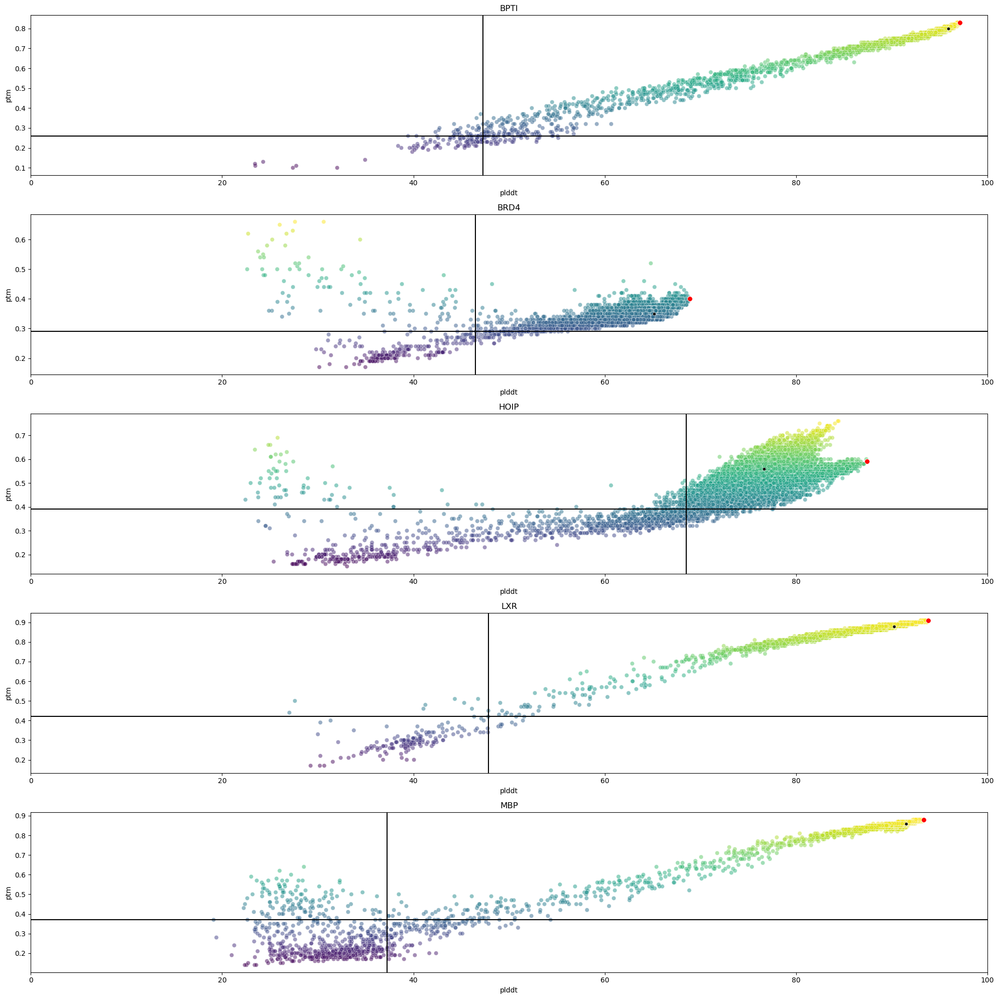

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


# plot RMSD for each protein as a histogram

fig, ax = plt.subplots(len(protein_names), 1, figsize=(20, 20))


thresholds = [(1,99.95),(2.5,99),(10,99.4),(1.25,99.9),(5,99.4)]

for i, protein in enumerate(protein_names):
    contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    print(contact_order.shape)
    print(protein)
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    ptm = ptm_data[protein]

    # det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
    # det = det/ det[0]
    # # make det all positive
    # # det = np.abs(det)
    # det = np.log(det)
    # print(np.mean(det))

    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    plddt = plddt_data[protein]

    max_plddt_index = np.where(plddt == np.max(plddt))
    # print(len(det))

    sns.scatterplot(x=plddt, y=ptm, ax=ax[i], alpha=0.5, c=ptm, cmap='viridis')
    # plot the 0th as a black dot
    sns.scatterplot(x=[plddt[ref_index]], y=[ptm[ref_index]], ax=ax[i], c="black",s=20)
    sns.scatterplot(x=plddt[max_plddt_index], y=ptm[max_plddt_index], ax=ax[i], c="red",s=50)
    # min_threshold
    ptm_threshold = np.percentile(ptm,thresholds[i][0])
    # max_threshold = np.percentile(plddt,100)
    plddt_threshold =np.percentile(plddt,thresholds[i][0])
    # ax[i].axvline(50)
    ax[i].axvline(plddt_threshold, c="black")

    ax[i].axhline(ptm_threshold, c="black")

    print(ptm_threshold)
    # print(np.min(contact_order))
    ax[i].set_title(protein)
    ax[i].set_xlabel("plddt")
    ax[i].set_ylabel("ptm")
    # ax[i].set_xscale("log")
    ax[i].set_xlim(0,100)


plt.tight_layout()

plt.show() 

In [29]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np


# # plot RMSD for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(20, 10))
# thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
# conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]

# for i, protein in enumerate(protein_names):
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     print(contact_order.shape)
#     print(protein)
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]

#     # det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
#     # det = det/ det[0]
#     # # make det all positive
#     # # det = np.abs(det)
#     # det = np.log(det)
#     # print(np.mean(det))
#     plddt = plddt_data[protein]
#     # ptm = 
#     # print(len(det))    
#     if protein == "BRD4":
#         ref_index = 1
#     else:
#         ref_index = 0
#     plddt = plddt_data[protein]

#     max_plddt_index = np.where(plddt == np.max(plddt))

#     sns.scatterplot(y=contact_order, x=covariance, ax=ax[i], alpha=0.5, c=plddt, cmap='viridis')
#     # plot the 0th as a black dot
#     sns.scatterplot(y=[contact_order[ref_index]], x=[covariance[ref_index]], ax=ax[i], c="black")
#     sns.scatterplot(y=contact_order[max_plddt_index], x=covariance[max_plddt_index], ax=ax[i], c="red",s=50)

#     max_threshold = np.percentile(covariance,thresholds[i][1])
#     min_threshold = np.percentile(covariance,thresholds[i][0])

#     ax[i].axvline(max_threshold,c="blue")
#     ax[i].axvline(min_threshold,c="grey")
#     ax[i].set_title(protein)
#     ax[i].set_ylabel("contact_order")
#     ax[i].set_xlabel("cov")
#     ax[i].set_yscale("log")
#     # ax[i].set_xscale("log")


# plt.tight_layout()

# plt.show() 

(12700,)
BPTI
(12700,)
BRD4
(12700,)
HOIP
(12700,)
LXR
(12700,)
MBP


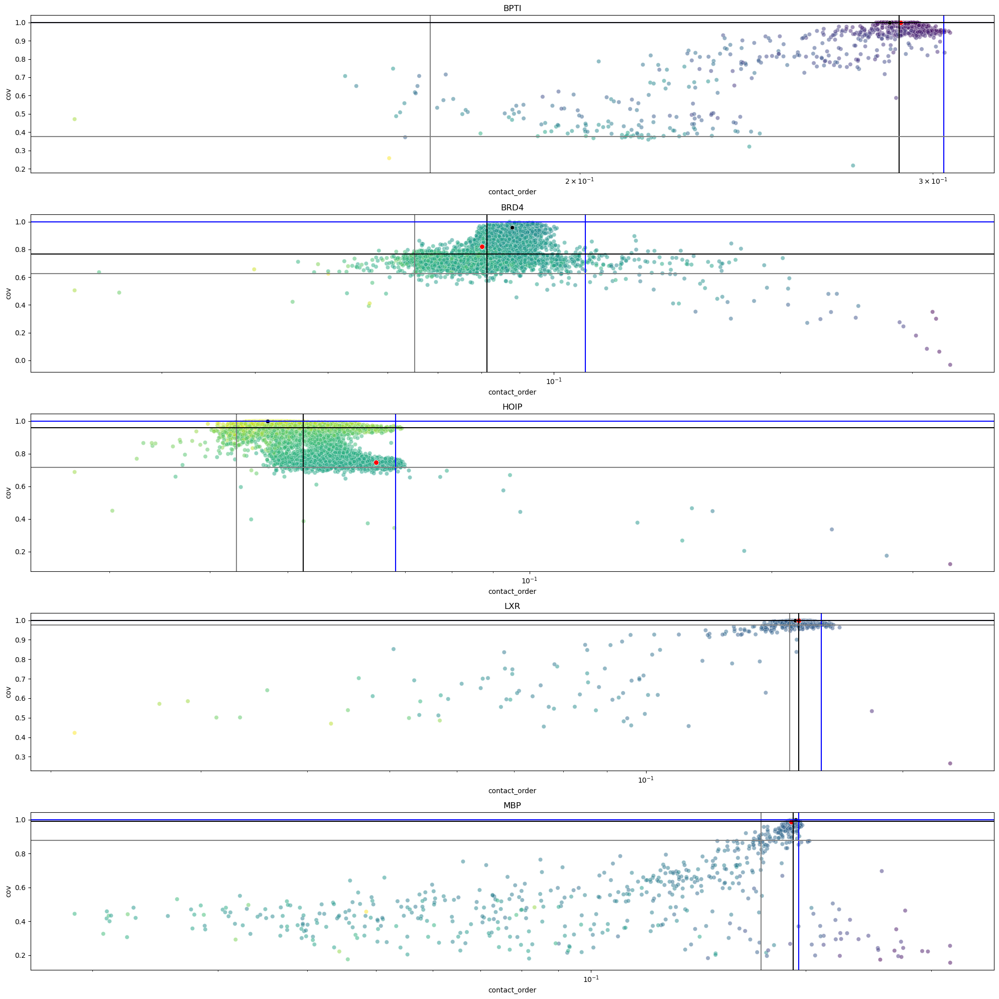

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


# plot RMSD for each protein as a histogram
conf_thresholds = [(1,99.95),(2.5,99),(10,99.4),(1.25,99.9),(5,99.4)]

fig, ax = plt.subplots(len(protein_names), 1, figsize=(20, 20))
thresholds = [(0.1,99.95),(1,99),(1.5,99.4),(2,99.5),(3.5,99.5)]
cov_thresholds = [(0.1,99.9),(1,99.8),(1.5,99.9),(1.5,99.9),(4,99.9)]

for i, protein in enumerate(protein_names):
    contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    print(contact_order.shape)
    print(protein)
    intra_res = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    # det = intra_residue_det_df[intra_residue_det_df["protein"] == protein]["intra_residue_det"].values[0]
    # det = det/ det[0]
    # # make det all positive
    # # det = np.abs(det)
    # det = np.log(det)
    # print(np.mean(det))
    plddt = plddt_data[protein]
    # ptm = 
    # print(len(det))    
    if protein == "BRD4":
        ref_index = 1
    else:
        ref_index = 0
    plddt = plddt_data[protein]

    max_plddt_index = np.where(plddt == np.max(plddt))


    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]




    sns.scatterplot(x=masked_contact_order, y=masked_covariance, ax=ax[i], alpha=0.5, c=intra_res[combined_mask], cmap='viridis')
    # plot the 0th as a black dot
    sns.scatterplot(x=[contact_order[ref_index]], y=[covariance[ref_index]], ax=ax[i], c="black")
    sns.scatterplot(x=contact_order[max_plddt_index], y=covariance[max_plddt_index], ax=ax[i], c="red",s=50)

    max_threshold = np.percentile(masked_contact_order,thresholds[i][1])
    min_threshold = np.percentile(masked_contact_order,thresholds[i][0])

    med_threshold =np.percentile(masked_contact_order,50)
    ax[i].axvline(max_threshold,c="blue")
    ax[i].axvline(min_threshold,c="grey")
    ax[i].axvline(med_threshold,c="black")


    max_threshold = np.percentile(masked_covariance,100)
    min_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    med_threshold =np.percentile(masked_covariance,50)
    ax[i].axhline(max_threshold,c="blue")
    ax[i].axhline(min_threshold,c="grey")
    ax[i].axhline(med_threshold,c="black")



    ax[i].set_title(protein)
    ax[i].set_xlabel("contact_order")
    ax[i].set_ylabel("cov")
    # ax[i].set_xscale("log")
    ax[i].set_xscale("log")


plt.tight_layout()

plt.show() 

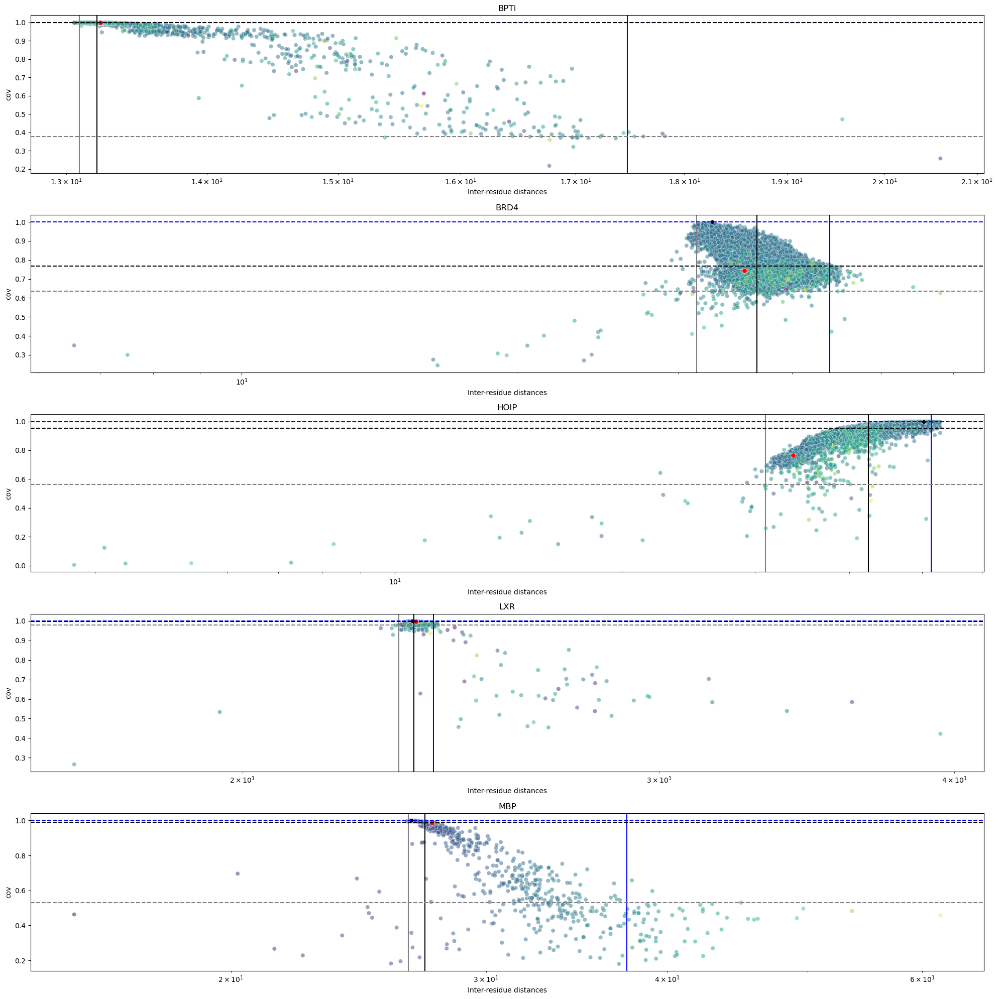

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]
con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.5)]



fig, ax = plt.subplots(len(protein_names), 1, figsize=(20, 20))

all_masks_frames = {}
con_cov_masks_frames = {}
conf_masks_frames = {}
no_mask_frames = {}


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]

    masked_covariance = covariance[combined_mask][con_cov_mask]

    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    med_dist = np.percentile(masked_intra_residue_dists,50)
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)
    feats_all = pca
    
    feats= pca[combined_mask][con_cov_mask][dist_mask]

    masked_intra_res = intra_res[combined_mask][con_cov_mask]

    # masked_covariance = covariance[combined_mask][con_cov_mask]

    sns.scatterplot(x=masked_intra_residue_dists, y=masked_covariance, ax=ax[i], alpha=0.5, c=masked_intra_res, cmap='viridis')
    # plot the 0th as a black dot
    sns.scatterplot(x=[masked_intra_residue_dists[ref_index]], y=[covariance[ref_index]], ax=ax[i], c="black")
    sns.scatterplot(x=[masked_intra_residue_dists[max_plddt_index]], y=[covariance[max_plddt_index]], ax=ax[i], c="red",s=50)

    # # max_threshold = np.perce
    ax[i].axvline(max_dist,c="blue", linewidth=1.5)
    ax[i].axvline(min_dist,c="grey", linewidth=1.5)
    ax[i].axvline(med_dist,c="black", linewidth=1.5)


    max_threshold = np.percentile(masked_covariance,100)
    min_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    med_threshold =np.percentile(masked_covariance,50)
    ax[i].axhline(max_threshold,c="blue", linestyle='--')
    ax[i].axhline(min_threshold,c="grey", linestyle='--')
    ax[i].axhline(med_threshold,c="black", linestyle='--')



    ax[i].set_title(protein)
    ax[i].set_xlabel("Inter-residue distances")
    ax[i].set_ylabel("cov")
    # ax[i].set_xscale("log")
    ax[i].set_xscale("log")


plt.tight_layout()

plt.show() 

In [31]:
intra_residue_dist_df.head()

,protein,intra_residue_dist
0,BPTI,"[13.232951933061988, 13.190497781660188, 13.22..."
0,BRD4,"[32.70503005458959, 33.47290030626461, 33.6224..."
0,HOIP,"[50.19557437856041, 50.38661655978589, 50.3992..."
0,LXR,"[23.597775656093493, 23.572432943074144, 23.63..."
0,MBP,"[26.641903590281288, 26.652556966979954, 26.91..."


In [32]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot intra res distances for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

# for i, protein in enumerate(protein_names):

#     sns.histplot(intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0], ax=ax[i], bins=50)
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Intra-residue distances")
#     ax[i].set_ylabel("Frequency")
#     ax[i].set_yscale("log")

# plt.tight_layout()
# plt.show()


In [33]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot RMSD for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

# for i, protein in enumerate(protein_names):

#     sns.histplot(RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0], ax=ax[i])
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("RMSD")

# plt.tight_layout()
# plt.yscale("log")
# plt.show()


In [34]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot RMSD for each protein as a histogram

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

# for i, protein in enumerate(protein_names):

#     sns.scatterplot(x=intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0],
#                     y=RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0], ax=ax[i], c=plddt_data[protein], cmap="viridis", alpha=0.5)
#     # plot the 0th as a black dot
#     sns.scatterplot(x=[intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0][0]],
#                     y=[RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0][0]], ax=ax[i], c="black")
    
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Intra-residue distances")
#     ax[i].set_ylabel("RMSD")

# plt.tight_layout()

# plt.show()

In [35]:
# import pandas as pd
# import plotly.graph_objects as go
# from plotly.subplots import make_subplots

# # Create a 3D plot for each protein
# fig = make_subplots(
#     rows=len(protein_names), cols=1,
#     specs=[[{'type': 'scene'}] for _ in range(len(protein_names))],
#     subplot_titles=protein_names,
#     vertical_spacing=0.05
# )

# for i, protein in enumerate(protein_names):
#     intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
#     # rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     # plddt = plddt_data[protein]
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     plddt = plddt_data[protein]
#     max_pae = max_pae_data[protein]
#     ptm = ptm_data[protein]
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]

#     median_cov = np.median(covariance)
#     mean_cov = np.mean(covariance)
#     max_cov = np.max(covariance)
#     mean_cov = np.mean(covariance)

#     cov_threshold = median_cov/2
#     plddt_threshold = 50
#     ptm_threshfold = 0.5


#     median_con = np.median(contact_order)
#     mean_con = np.mean(contact_order)
#     max_con = np.percentile(contact_order,99)
#     mean_con = np.mean(contact_order)
#     min_con = np.percentile(contact_order,1)



#     # labels = [0 if (pl < plddt_threshold and pt < ptm_threshfold) else 1 for pl, pt in zip(plddt, ptm)]

#     labels = []

#     for idx,  pt in enumerate(ptm):
#         pl = plddt[idx]
#         con = contact_order[idx]
#         cov = covariance[idx]

#         if (min_con >= con or con >= max_cov):
#             label=0.5

#         elif (pl >= plddt_threshold and pt >= ptm_threshfold):
#             label = 1
        
#         if cov <= cov_threshold:
#             label = 0
#             # continue

#         labels.append(label)




#     # d1_pca = pca_df.loc[(pca_df["protein"] == protein) & (pca_df["n_dims"] == 1), "pca"].values[0]
#     trace = go.Scatter3d(
#         x=rmsd,
#         y=covariance,
#         z=(contact_order),
#         mode='markers',
#         marker=dict(
#             size=3,
#             color=labels,
#             colorscale='Viridis',
#             opacity=0.8
#         ),
#         name=protein,
#         scene=f'scene{i+1}',
#         hovertemplate='Element: %{pointNumber}<br>RMSD: %{x:.2f}<br>Intra-Residue Distance: %{y:.2f}<br>pLDDT: %{z:.2f}<extra></extra>'

#     )

#     fig.add_trace(trace, row=i+1, col=1)
    
#     fig.update_scenes(
#         xaxis_title='RMSD',
#         yaxis_title='covariance',
#         zaxis_title='contact_order',
#         row=i+1, col=1
#     )

# fig.update_layout(
#     height=300 * len(protein_names),
#     width=800,
#     title_text='3D Scatter Plot of RMSD, Intra-Residue Distance, and pLDDT',
#     showlegend=False
# )

# fig.show()

In [36]:
# import pandas as pd
# import plotly.graph_objects as go
# from plotly.subplots import make_subplots

# # Create a 3D plot for each protein
# fig = make_subplots(
#     rows=len(protein_names), cols=1,
#     specs=[[{'type': 'scene'}] for _ in range(len(protein_names))],
#     subplot_titles=protein_names,
#     vertical_spacing=0.05
# )

# for i, protein in enumerate(protein_names):
#     intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
#     # rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     # plddt = plddt_data[protein]
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     plddt = plddt_data[protein]
#     max_pae = max_pae_data[protein]
#     ptm = ptm_data[protein]
#     contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]


#     pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
#     pca1 = pca[:,0]
#     pca2 = pca[:,1]

#     median_cov = np.median(covariance)
#     mean_cov = np.mean(covariance)
#     max_cov = np.max(covariance)
#     mean_cov = np.mean(covariance)

#     cov_threshold = median_cov/2
#     plddt_threshold = 50
#     ptm_threshfold = 0.5


#     median_con = np.median(contact_order)
#     mean_con = np.mean(contact_order)
#     max_con = np.percentile(contact_order,99)
#     mean_con = np.mean(contact_order)
#     min_con = np.percentile(contact_order,1)



#     # labels = [0 if (pl < plddt_threshold and pt < ptm_threshfold) else 1 for pl, pt in zip(plddt, ptm)]

#     labels = []

#     for idx,  pt in enumerate(ptm):
#         pl = plddt[idx]
#         con = contact_order[idx]
#         cov = covariance[idx]

#         if (min_con >= con or con >= max_cov):
#             label=0.5

#         elif (pl >= plddt_threshold and pt >= ptm_threshfold):
#             label = 1
        
#         if cov <= cov_threshold:
#             label = 0
#             # continue

#         labels.append(label)




#     # d1_pca = pca_df.loc[(pca_df["protein"] == protein) & (pca_df["n_dims"] == 1), "pca"].values[0]
#     trace = go.Scatter(
#         x=pca1,
#         y=pca2,
#         mode='markers',
#         marker=dict(
#             size=3,
#             color=labels,
#             colorscale='Viridis',
#             opacity=0.8
#         ),
#         name=protein,
#         scene=f'scene{i+1}',
#         hovertemplate='Element: %{pointNumber}<br>RMSD: %{x:.2f}<br>Intra-Residue Distance: %{y:.2f}<br>pLDDT: %{z:.2f}<extra></extra>'

#     )

#     fig.add_trace(trace, row=i+1, col=1)
    
#     fig.update_scenes(
#         xaxis_title='RMSD',
#         yaxis_title='covariance',
#         zaxis_title='contact_order',
#         row=i+1, col=1
#     )

# fig.update_layout(
#     height=300 * len(protein_names),
#     width=800,
#     title_text='3D Scatter Plot of RMSD, Intra-Residue Distance, and pLDDT',
#     showlegend=False
# )

# fig.show()

In [37]:
# import pandas as pd
# import plotly.graph_objects as go
# from plotly.subplots import make_subplots

# # Create a 3D plot for each protein
# fig = make_subplots(
#     rows=len(protein_names), cols=1,
#     specs=[[{'type': 'scene'}] for _ in range(len(protein_names))],
#     subplot_titles=protein_names,
#     vertical_spacing=0.05
# )

# for i, protein in enumerate(protein_names):
#     intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
#     # rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     # plddt = plddt_data[protein]
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     plddt = plddt_data[protein]

#     plddt_threshold = 50
#     ptm_threshfold = 0.5




#     labels = [0 if (pl < plddt_threshold and pt < ptm_threshfold) else 1 for pl, pt in zip(plddt, ptm)]

#     trace = go.Scatter3d(
#         x=rmsd,
#         y=ptm,
#         z=np.log(contact_order),
#         mode='markers',
#         marker=dict(
#             size=3,
#             color=labels,
#             colorscale='Viridis',
#             opacity=0.8
#         ),
#         name=protein,
#         scene=f'scene{i+1}',
#         hovertemplate='Element: %{pointNumber}<br>RMSD: %{x:.2f}<br>Intra-Residue Distance: %{y:.2f}<br>pLDDT: %{z:.2f}<extra></extra>'

#     )

#     fig.add_trace(trace, row=i+1, col=1)
    
#     fig.update_scenes(
#         xaxis_title='rmsd',
#         yaxis_title='covariance',
#         zaxis_title='contact_order',
#         row=i+1, col=1
#     )

# fig.update_layout(
#     height=300 * len(protein_names),
#     width=800,
#     title_text='3D Scatter Plot of RMSD, Intra-Residue Distance, and pLDDT',
#     showlegend=False
# )

# fig.show()

In [38]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

# con_thresholds = [(0.5,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
con_thresholds = [(0.2,99.95),(0.5,99),(1,99.5),(0.75,99.9),(2,99.7)]
# cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
cov_thresholds = [(0.02,99.95),(1,99.5),(1,99.5),(1,99.9),(5,99.7)]

conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    
    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,cov_thresholds[i][0])
    print(max_cov)
    print(min_cov)
    # cov_threshold = np.percentile(covariance,con_thresholds[i][0]/10)
   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
    median_con = np.median(contact_order)
    mean_con = np.mean(contact_order)
    max_con = np.percentile(contact_order,100)
    mean_con = np.mean(contact_order)
    min_con = np.percentile(contact_order,con_thresholds[i][0])

    labels = []
    for idx, pt in enumerate(ptm):
        pl = plddt[idx]
        con = contact_order[idx]
        cov = covariance[idx]

        if (pl < plddt_threshold and pt < ptm_threshold):
            label = 0
        elif (con < min_con) or (con > max_con):
            label = 0.1
        elif(cov <= min_cov):
            label = 0.8
        # elif pt < ptm_threshold:
        #     label = 0.4
        else:
            label = 1
     

        labels.append(label)




    

    trace = go.Scatter(
        x=pca1,
        y=pca2,
        mode='markers',
        marker=dict(
            size=5,
            color=covariance,
            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='Label',
                len=0.8,
                thickness=20,
                tickvals=[0,0.4 ,0.8, 0.1, 1],
                ticktext=['Bad pLDDT & PTM', 'Bad PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )

    fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

1.0
0.23433225373282707
1.0
0.6222240220953306
0.9999999999999999
0.5457071474516241
1.0
0.6661624585416853
0.9999999999999999
0.5232549658856999


In [39]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]
res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)


    # mask_indexes = np.where(labels == 1)[0]
    # print(mask_indexes.shape)
    trace = go.Scatter(
        x=pca1[combined_mask][con_cov_mask][dist_mask],
        y=pca2[combined_mask][con_cov_mask][dist_mask],
        mode='markers',
        marker=dict(
            size=6,
            color=intra_residue_dists[combined_mask][con_cov_mask][dist_mask],
            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='ptm',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_trace = go.Scatter(
        x=[pca1[ref_index]],
        y=[pca2[ref_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[pca1[max_plddt_index]],
        y=[pca2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

In [40]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]
res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)


    # mask_indexes = np.where(labels == 1)[0]
    # print(mask_indexes.shape)
    trace = go.Scatter(
        x=pca1[combined_mask][con_cov_mask][dist_mask],
        y=pca2[combined_mask][con_cov_mask][dist_mask],
        mode='markers',
        marker=dict(
            size=6,
            color=intra_residue_dists[combined_mask][con_cov_mask][dist_mask],
            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='ptm',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_trace = go.Scatter(
        x=[pca1[ref_index]],
        y=[pca2[ref_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[pca1[max_plddt_index]],
        y=[pca2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

In [41]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.cluster import KMeans
#

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

con_thresholds = [(0.1,99.95),(1,99),(1.5,99.4),(2,99.5),(4,99.5)]
cov_thresholds = [(0.1,99.9),(1,99.8),(1.5,99.9),(1.5,99.9),(4,99.9)]
conf_thresholds = [(1,99.95),(2.5,99),(10,99.4),(1.25,99.9),(5,99.4)]
res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    tsne = tsne_df[tsne_df["protein"]==protein]["tsne"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    
    tsne1 = tsne[:,0]
    tsne2   = tsne[:,1]
   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_and(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)

    feats = tsne[combined_mask][con_cov_mask][dist_mask]
    # feat2 = pca2[combined_mask][con_cov_mask][dist_mask]

    k_clusters = 10

    kmeans = KMeans(n_clusters=k_clusters, random_state=42)

    kmeans.fit(feats)

    k_labels = kmeans.labels_
    
    


    # mask_indexes = np.where(labels == 1)[0]
    # print(mask_indexes.shape)
    trace = go.Scatter(
        x=tsne1[combined_mask][con_cov_mask][dist_mask],
        y=tsne2[combined_mask][con_cov_mask][dist_mask],
        mode='markers',
        marker=dict(
            size=6,
            # title_text='k_labels',
            # color=covariance[combined_mask][con_cov_mask][dist_mask],
            color=k_labels,

            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='k_labels',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>k_labels: %{text}<extra></extra>',
        text=k_labels,

    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_index = [(i*100) for i in range(120)]
    ref_trace = go.Scatter(
        x=tsne1[ref_index],
        y=tsne2[ref_index],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        text = ref_index,
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>ref_index: %{text}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[tsne1[max_plddt_index]],
        y=[tsne2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='tSNE1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='tSNE2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of tsne1 and tsne2',
    showlegend=False
)

fig.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/en

In [42]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.cluster import KMeans
#

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]
res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)

    feats = pca[combined_mask][con_cov_mask]
    # feat2 = pca2[combined_mask][con_cov_mask][dist_mask]

    k_clusters = 8

    kmeans = KMeans(n_clusters=k_clusters, random_state=42)

    kmeans.fit(feats)

    k_labels = kmeans.labels_
    
    


    # mask_indexes = np.where(labels == 1)[0]
    # print(mask_indexes.shape)
    trace = go.Scatter(
        x=pca1[combined_mask][con_cov_mask],
        y=pca2[combined_mask][con_cov_mask],
        mode='markers',
        marker=dict(
            size=6,
            # title_text='k_labels',
            color=k_labels,
            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='k_labels',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>k_labels: %{text}<extra></extra>',
        text=k_labels,

    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_trace = go.Scatter(
        x=[pca1[ref_index]],
        y=[pca2[ref_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[pca1[max_plddt_index]],
        y=[pca2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/en

In [68]:
# import pandas as pd
# import plotly.graph_objects as go
# from plotly.subplots import make_subplots
# from sklearn.cluster import KMeans
# #

# # Create a 3D plot for each protein
# fig = make_subplots(
#     rows=len(protein_names), cols=1,
#     specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
#     subplot_titles=protein_names,
#     vertical_spacing=0.05
# )

# con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
# cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
# conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]
# res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


# for i, protein in enumerate(protein_names):
#     intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     plddt = plddt_data[protein]
#     max_pae = max_pae_data[protein]
#     ptm = ptm_data[protein]
#     c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
#     pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
#     pca1 = pca[:,0]
#     pca2 = pca[:,1]
    

   
#     plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
#     ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


#     # labels = []    
#     # for idx, pt in enumerate(ptm):
#     #     pl = plddt[idx]
#     #     con = contact_order[idx]
#     #     cov = covariance[idx]

#     #     if (pl < plddt_threshold and pt < ptm_threshold):
#     #         label = 0
#     #     elif (con < min_con) or (con > max_con):
#     #         label = 0
#     #     elif(cov < min_cov):
#     #         label = 0
#     #     # elif pt < ptm_threshold:
#     #     #     label = 0.4
#     #     else:
#     #         label = 1
     
#     #     labels.append(label)
#     # labels = np.array(labels)

#     plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
#     ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
#         # Create a mask for plddt values below the threshold
#     plddt_mask = (plddt > plddt_threshold)

#     # Create a mask for ptm values below the threshold
#     ptm_mask = (ptm > ptm_threshold)

#     # Combine the masks using logical o
#     combined_mask = np.logical_or(plddt_mask,ptm_mask)

#     masked_contact_order = contact_order[combined_mask]
#     masked_covariance = covariance[combined_mask]
#     masked_intra_residue_dists = intra_residue_dists[combined_mask]
#     # masked_pca = pca[combined_mask]

#     max_cov = np.percentile(covariance,100)
#     mean_cov = np.mean(covariance)

#     min_cov = np.percentile(covariance,1)
#     # print(max_cov)
#     # print(min_cov)
#     cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

#     median_con = np.median(masked_contact_order)
#     mean_con = np.mean(masked_contact_order)
#     max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
#     mean_con = np.mean(masked_contact_order)

#     min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

#     min_con_mask = (masked_contact_order > min_con)
#     max_con_mask = (masked_contact_order < max_con)

#     con_mask = np.logical_and(min_con_mask,max_con_mask)

#     cov_mask = (masked_covariance > cov_threshold)

#     con_cov_mask = np.logical_or(con_mask,cov_mask)


#     masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


#     min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
#     max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
#     min_dist_mask = (masked_intra_residue_dists > min_dist)
#     max_dist_mask = (masked_intra_residue_dists < max_dist)


#     dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

#     # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)

#     feats = pca[combined_mask]
#     # feat2 = pca2[combined_mask][con_cov_mask][dist_mask]

#     k_clusters = 8

#     kmeans = KMeans(n_clusters=k_clusters, random_state=42)

#     kmeans.fit(feats)

#     k_labels = kmeans.labels_
    
    


#     # mask_indexes = np.where(labels == 1)[0]
#     # print(mask_indexes.shape)
#     trace = go.Scatter(
#         x=pca1[combined_mask],
#         y=pca2[combined_mask],
#         mode='markers',
#         marker=dict(
#             size=6,
#             # title_text='k_labels',
#             color=k_labels,
#             colorscale='Viridis',
#             opacity=0.5,
#             colorbar=dict(  # Added colorbar
#                 title='k_labels',
#                 len=0.8,
#                 thickness=20,
#                 # tickvals=[0, 0.75, 0.4, 1],
#                 # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
#             )
#         ),
#         name=protein,
#         hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>k_labels: %{text}<extra></extra>',
#         text=k_labels,

#     )

#     fig.add_trace(trace, row=i+1, col=1)
    
#     ref_index = 1 if protein == "BRD4" else 0
#     ref_trace = go.Scatter(
#         x=[pca1[ref_index]],
#         y=[pca2[ref_index]],
#         mode='markers',
#         marker=dict(
#             size=10,
#             color='black',
#             symbol='square'
#         ),
#         name='Reference',
#         hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
#     )
#     fig.add_trace(ref_trace, row=i+1, col=1)
    
#     # Plot the maximum pLDDT index as a red dot
#     max_plddt_index = np.argmax(plddt)
#     max_plddt_trace = go.Scatter(
#         x=[pca1[max_plddt_index]],
#         y=[pca2[max_plddt_index]],
#         mode='markers',
#         marker=dict(
#             size=10,
#             color='red',
#             symbol='star'
#         ),
#         name='Max pLDDT',
#         hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
#     )
#     fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
#     # trace = go.Scatter(
#     #     x=pca1[~mask_indexes],
#     #     y=pca2[~mask_indexes],
#     #     mode='markers',
#     #     marker=dict(
#     #         size=5,
#     #         color='Grey',
#     #         # colorscale='Grey',
#     #         opacity=0.1,
#     #         colorbar=dict(  # Added colorbar
#     #             title='ptm',
#     #             len=0.8,
#     #             thickness=20,
#     #             # tickvals=[0, 0.75, 0.4, 1],
#     #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
#     #         )
#     #     ),
#     #     name=protein,
#     #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
#     # )

#     # fig.add_trace(trace, row=i+1, col=1)
    
#     fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
#     fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

# fig.update_layout(
#     height=300 * len(protein_names),
#     width=800,
#     title_text='2D Scatter Plot of PCA1 and PCA2',
#     showlegend=False
# )

# fig.show()

In [69]:
# import pandas as pd
# import plotly.graph_objects as go
# from plotly.subplots import make_subplots
# from sklearn.cluster import KMeans
# #

# # Create a 3D plot for each protein
# fig = make_subplots(
#     rows=len(protein_names), cols=1,
#     specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
#     subplot_titles=protein_names,
#     vertical_spacing=0.05
# )

# con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
# cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
# conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]
# res_thresholds = [(0.1,99.95),(1,99.5),(0.25,99.4),(0.05,99.5),(0.25,99.9)]


# for i, protein in enumerate(protein_names):
#     intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     plddt = plddt_data[protein]
#     max_pae = max_pae_data[protein]
#     ptm = ptm_data[protein]
#     c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
#     covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
#     pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
#     pca1 = pca[:,0]
#     pca2 = pca[:,1]
    

   
#     plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
#     ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


#     # labels = []    
#     # for idx, pt in enumerate(ptm):
#     #     pl = plddt[idx]
#     #     con = contact_order[idx]
#     #     cov = covariance[idx]

#     #     if (pl < plddt_threshold and pt < ptm_threshold):
#     #         label = 0
#     #     elif (con < min_con) or (con > max_con):
#     #         label = 0
#     #     elif(cov < min_cov):
#     #         label = 0
#     #     # elif pt < ptm_threshold:
#     #     #     label = 0.4
#     #     else:
#     #         label = 1
     
#     #     labels.append(label)
#     # labels = np.array(labels)

#     plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
#     ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
#         # Create a mask for plddt values below the threshold
#     plddt_mask = (plddt > plddt_threshold)

#     # Create a mask for ptm values below the threshold
#     ptm_mask = (ptm > ptm_threshold)

#     # Combine the masks using logical o
#     combined_mask = np.logical_or(plddt_mask,ptm_mask)

#     masked_contact_order = contact_order[combined_mask]
#     masked_covariance = covariance[combined_mask]
#     masked_intra_residue_dists = intra_residue_dists[combined_mask]
#     # masked_pca = pca[combined_mask]

#     max_cov = np.percentile(covariance,100)
#     mean_cov = np.mean(covariance)

#     min_cov = np.percentile(covariance,1)
#     # print(max_cov)
#     # print(min_cov)
#     cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

#     median_con = np.median(masked_contact_order)
#     mean_con = np.mean(masked_contact_order)
#     max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
#     mean_con = np.mean(masked_contact_order)

#     min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

#     min_con_mask = (masked_contact_order > min_con)
#     max_con_mask = (masked_contact_order < max_con)

#     con_mask = np.logical_and(min_con_mask,max_con_mask)

#     cov_mask = (masked_covariance > cov_threshold)

#     con_cov_mask = np.logical_or(con_mask,cov_mask)


#     masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


#     min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
#     max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
#     min_dist_mask = (masked_intra_residue_dists > min_dist)
#     max_dist_mask = (masked_intra_residue_dists < max_dist)


#     dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

#     # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)

#     feats = pca
#     # feat2 = pca2[combined_mask][con_cov_mask][dist_mask]

#     k_clusters = 8

#     kmeans = KMeans(n_clusters=k_clusters, random_state=42)

#     kmeans.fit(feats)

#     k_labels = kmeans.labels_
    
    


#     # mask_indexes = np.where(labels == 1)[0]
#     # print(mask_indexes.shape)
#     trace = go.Scatter(
#         x=pca1,
#         y=pca2,
#         mode='markers',
#         marker=dict(
#             size=6,
#             # title_text='k_labels',
#             color=k_labels,
#             colorscale='Viridis',
#             opacity=0.5,
#             colorbar=dict(  # Added colorbar
#                 title='k_labels',
#                 len=0.8,
#                 thickness=20,
#                 # tickvals=[0, 0.75, 0.4, 1],
#                 # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
#             )
#         ),
#         name=protein,
#         hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<br>k_labels: %{text}<extra></extra>',
#         text=k_labels,

#     )

#     fig.add_trace(trace, row=i+1, col=1)
    
#     ref_index = 1 if protein == "BRD4" else 0
#     ref_trace = go.Scatter(
#         x=[pca1[ref_index]],
#         y=[pca2[ref_index]],
#         mode='markers',
#         marker=dict(
#             size=10,
#             color='black',
#             symbol='square'
#         ),
#         name='Reference',
#         hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
#     )
#     fig.add_trace(ref_trace, row=i+1, col=1)
    
#     # Plot the maximum pLDDT index as a red dot
#     max_plddt_index = np.argmax(plddt)
#     max_plddt_trace = go.Scatter(
#         x=[pca1[max_plddt_index]],
#         y=[pca2[max_plddt_index]],
#         mode='markers',
#         marker=dict(
#             size=10,
#             color='red',
#             symbol='star'
#         ),
#         name='Max pLDDT',
#         hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
#     )
#     fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
#     # trace = go.Scatter(
#     #     x=pca1[~mask_indexes],
#     #     y=pca2[~mask_indexes],
#     #     mode='markers',
#     #     marker=dict(
#     #         size=5,
#     #         color='Grey',
#     #         # colorscale='Grey',
#     #         opacity=0.1,
#     #         colorbar=dict(  # Added colorbar
#     #             title='ptm',
#     #             len=0.8,
#     #             thickness=20,
#     #             # tickvals=[0, 0.75, 0.4, 1],
#     #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
#     #         )
#     #     ),
#     #     name=protein,
#     #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
#     # )

#     # fig.add_trace(trace, row=i+1, col=1)
    
#     fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
#     fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

# fig.update_layout(
#     height=300 * len(protein_names),
#     width=800,
#     title_text='2D Scatter Plot of PCA1 and PCA2',
#     showlegend=False
# )

# fig.show()

In [45]:

all_masks_frames = {}
con_cov_masks_frames = {}
conf_masks_frames = {}
no_mask_frames = {}


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    masked_intra_residue_dists = intra_residue_dists[combined_mask][con_cov_mask]


    min_dist =  np.percentile(masked_intra_residue_dists,res_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,res_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    # dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)
    feats_all = pca
    
    feats= pca[combined_mask][con_cov_mask][dist_mask]

    feats_con = pca[combined_mask][con_cov_mask]

    feats_conf = pca[combined_mask]

    # feat2 = pca2[combined_mask][con_cov_mask][dist_mask]


    k_clusters = 10

    kmeans = KMeans(n_clusters=k_clusters, random_state=42)

    kmeans.fit(feats_all)

    # Get the cluster centers
    cluster_centers = kmeans.cluster_centers_

    # Find the closest frames to each cluster center
    closest_frames = kmeans.transform(feats_all).argmin(axis=0)

    no_mask_frames[protein] = closest_frames




    kmeans.fit(feats)

    # Get the cluster centers
    cluster_centers = kmeans.cluster_centers_

    # Find the closest frames to each cluster center
    closest_frames = kmeans.transform(feats).argmin(axis=0)

    all_masks_frames[protein] = closest_frames





    kmeans.fit(feats_con)

    # Get the cluster centers
    cluster_centers = kmeans.cluster_centers_

    # Find the closest frames to each cluster center
    closest_frames = kmeans.transform(feats_con).argmin(axis=0)

    con_cov_masks_frames[protein] = closest_frames




    kmeans.fit(feats_conf)

    # Get the cluster centers
    cluster_centers = kmeans.cluster_centers_

    # Find the closest frames to each cluster center
    closest_frames = kmeans.transform(feats_conf).argmin(axis=0)

    conf_masks_frames[protein] = closest_frames





    # Print the indices of the closest frames for each cluster center
    for i, frame_idx in enumerate(closest_frames):
        print(f"Cluster {i+1}: Frame {frame_idx}")

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Cluster 1: Frame 8545
Cluster 2: Frame 11943
Cluster 3: Frame 12186
Cluster 4: Frame 10952
Cluster 5: Frame 12202
Cluster 6: Frame 12399
Cluster 7: Frame 11015
Cluster 8: Frame 12182
Cluster 9: Frame 12067
Cluster 10: Frame 12252


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Cluster 1: Frame 484
Cluster 2: Frame 10873
Cluster 3: Frame 611
Cluster 4: Frame 3681
Cluster 5: Frame 10280
Cluster 6: Frame 6321
Cluster 7: Frame 4829
Cluster 8: Frame 6280
Cluster 9: Frame 2064
Cluster 10: Frame 9444


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Cluster 1: Frame 6178
Cluster 2: Frame 5874
Cluster 3: Frame 12037
Cluster 4: Frame 4640
Cluster 5: Frame 4967
Cluster 6: Frame 9039
Cluster 7: Frame 8728
Cluster 8: Frame 12089
Cluster 9: Frame 8749
Cluster 10: Frame 12525


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Cluster 1: Frame 2568
Cluster 2: Frame 12267
Cluster 3: Frame 11881
Cluster 4: Frame 12270
Cluster 5: Frame 12263
Cluster 6: Frame 11025
Cluster 7: Frame 12451
Cluster 8: Frame 12457
Cluster 9: Frame 9891
Cluster 10: Frame 12538


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Cluster 1: Frame 6459
Cluster 2: Frame 12114
Cluster 3: Frame 4536
Cluster 4: Frame 11649
Cluster 5: Frame 12148
Cluster 6: Frame 9897
Cluster 7: Frame 9453
Cluster 8: Frame 12133
Cluster 9: Frame 12174
Cluster 10: Frame 12167


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



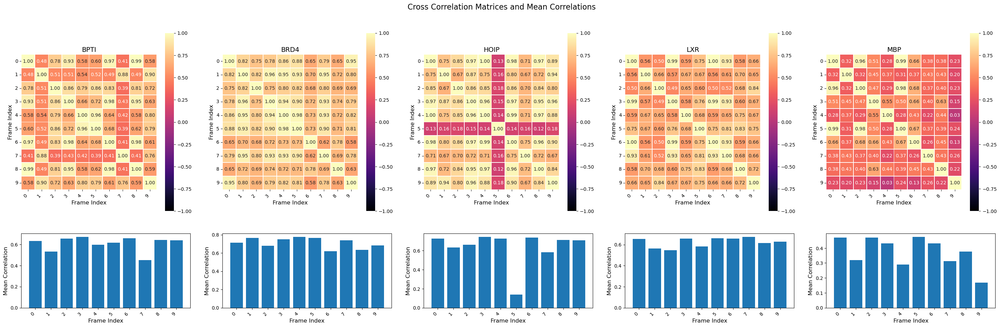

In [46]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_cross_correlation(universe, frame_indexes, residues:list=None):
    """
    After aligning the trajectory in memory, calculate the cross correlation
    of the intra-residue distances between the specified frame indexes.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    ref = universe.select_atoms(sel)

    # Align the trajectory to the first frame
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(frame_indexes)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrices for the specified frames
    dist_matrices = []
    for frame_index in frame_indexes:
        universe.trajectory[frame_index]
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        dist_matrices.append(dist_matrix)

    # Calculate the cross correlation between the specified frames
    cross_correlation_matrix = np.zeros((n_frames, n_frames))
    for i in range(n_frames):
        for j in range(n_frames):
            cross_correlation_matrix[i, j] = pearsonr(dist_matrices[i].flatten(), dist_matrices[j].flatten())[0]

    return cross_correlation_matrix

# ... (rest of the code remains the same)

intra_residue_cross_correlation_df = pd.DataFrame()

for protein in protein_names:
    frame_indexes = no_mask_frames[protein]
      # Specify the frame indexes for cross correlation calculation
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_cross_correlation = calc_intra_residue_cross_correlation(universe, frame_indexes, residues=residues)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_cross_correlation": [intra_residue_cross_correlation]})
    intra_residue_cross_correlation_df = pd.concat([intra_residue_cross_correlation_df, df_to_add], axis=0)

import seaborn as sns
import matplotlib.pyplot as plt

# Create a single figure with subplots for each protein
n_proteins = len(protein_names)
fig, axes = plt.subplots(2, n_proteins, figsize=(6 * n_proteins, 10), gridspec_kw={'height_ratios': [3, 1]})

for i, protein in enumerate(protein_names):
    cross_correlation_matrix = intra_residue_cross_correlation_df[intra_residue_cross_correlation_df["protein"] == protein]["intra_residue_cross_correlation"].values[0]
    row_sum = np.sum(cross_correlation_matrix, axis=1)
    mean_rows = [(row - 1) / len(row_sum) for row in row_sum]

    # Plot the heatmap on the corresponding subplot
    sns.heatmap(cross_correlation_matrix, cmap="magma", vmin=-1, vmax=1, annot=True, fmt=".2f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=axes[0, i])

    # Set the title and labels for each heatmap subplot
    axes[0, i].set_title(f"{protein}", fontsize=14)
    axes[0, i].set_xlabel("Frame Index", fontsize=12)
    axes[0, i].set_ylabel("Frame Index", fontsize=12)

    # Rotate the x-tick labels for better readability
    axes[0, i].set_xticklabels(axes[0, i].get_xticklabels(), rotation=45, ha='right', fontsize=10)
    axes[0, i].set_yticklabels(axes[0, i].get_yticklabels(), rotation=0, fontsize=10)

    # Plot the mean row as a bar chart on the corresponding subplot
    axes[1, i].bar(range(len(mean_rows)), mean_rows)
    axes[1, i].set_xlabel("Frame Index", fontsize=12)
    axes[1, i].set_ylabel("Mean Correlation", fontsize=12)
    axes[1, i].set_xticks(range(len(mean_rows)))
    axes[1, i].set_xticklabels(range(len(mean_rows)), rotation=45, ha='right', fontsize=10)

# Adjust the spacing between subplots
plt.tight_layout(pad=3.0)

# Add a main title for the entire figure
fig.suptitle("Cross Correlation Matrices and Mean Correlations", fontsize=16)

# Display the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



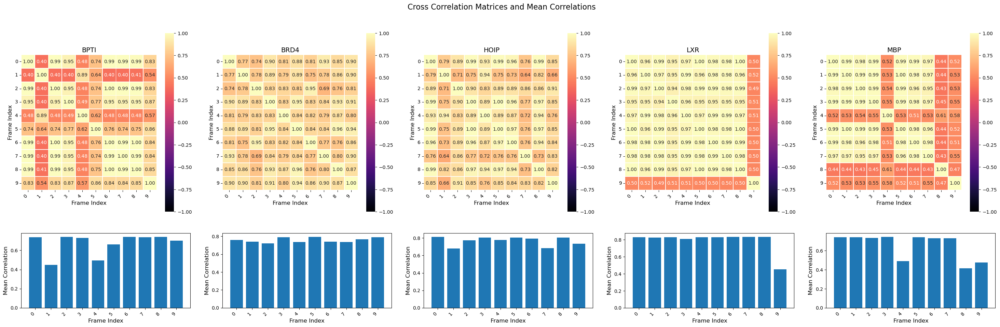

In [47]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_cross_correlation(universe, frame_indexes, residues:list=None):
    """
    After aligning the trajectory in memory, calculate the cross correlation
    of the intra-residue distances between the specified frame indexes.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    ref = universe.select_atoms(sel)

    # Align the trajectory to the first frame
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(frame_indexes)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrices for the specified frames
    dist_matrices = []
    for frame_index in frame_indexes:
        universe.trajectory[frame_index]
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        dist_matrices.append(dist_matrix)

    # Calculate the cross correlation between the specified frames
    cross_correlation_matrix = np.zeros((n_frames, n_frames))
    for i in range(n_frames):
        for j in range(n_frames):
            cross_correlation_matrix[i, j] = pearsonr(dist_matrices[i].flatten(), dist_matrices[j].flatten())[0]

    return cross_correlation_matrix

# ... (rest of the code remains the same)

intra_residue_cross_correlation_df = pd.DataFrame()

for protein in protein_names:
    frame_indexes = conf_masks_frames[protein]
      # Specify the frame indexes for cross correlation calculation
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_cross_correlation = calc_intra_residue_cross_correlation(universe, frame_indexes, residues=residues)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_cross_correlation": [intra_residue_cross_correlation]})
    intra_residue_cross_correlation_df = pd.concat([intra_residue_cross_correlation_df, df_to_add], axis=0)

import seaborn as sns
import matplotlib.pyplot as plt

# Create a single figure with subplots for each protein
n_proteins = len(protein_names)
fig, axes = plt.subplots(2, n_proteins, figsize=(6 * n_proteins, 10), gridspec_kw={'height_ratios': [3, 1]})

for i, protein in enumerate(protein_names):
    cross_correlation_matrix = intra_residue_cross_correlation_df[intra_residue_cross_correlation_df["protein"] == protein]["intra_residue_cross_correlation"].values[0]
    row_sum = np.sum(cross_correlation_matrix, axis=1)
    mean_rows = [(row - 1) / len(row_sum) for row in row_sum]

    # Plot the heatmap on the corresponding subplot
    sns.heatmap(cross_correlation_matrix, cmap="magma", vmin=-1, vmax=1, annot=True, fmt=".2f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=axes[0, i])

    # Set the title and labels for each heatmap subplot
    axes[0, i].set_title(f"{protein}", fontsize=14)
    axes[0, i].set_xlabel("Frame Index", fontsize=12)
    axes[0, i].set_ylabel("Frame Index", fontsize=12)

    # Rotate the x-tick labels for better readability
    axes[0, i].set_xticklabels(axes[0, i].get_xticklabels(), rotation=45, ha='right', fontsize=10)
    axes[0, i].set_yticklabels(axes[0, i].get_yticklabels(), rotation=0, fontsize=10)

    # Plot the mean row as a bar chart on the corresponding subplot
    axes[1, i].bar(range(len(mean_rows)), mean_rows)
    axes[1, i].set_xlabel("Frame Index", fontsize=12)
    axes[1, i].set_ylabel("Mean Correlation", fontsize=12)
    axes[1, i].set_xticks(range(len(mean_rows)))
    axes[1, i].set_xticklabels(range(len(mean_rows)), rotation=45, ha='right', fontsize=10)

# Adjust the spacing between subplots
plt.tight_layout(pad=3.0)

# Add a main title for the entire figure
fig.suptitle("Cross Correlation Matrices and Mean Correlations", fontsize=16)

# Display the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



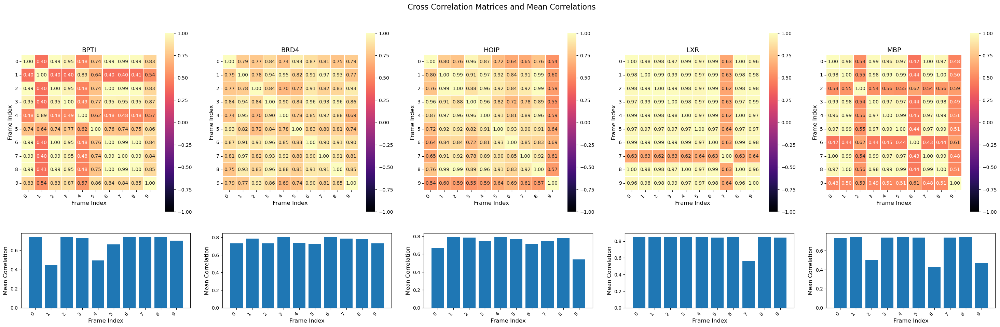

In [48]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_cross_correlation(universe, frame_indexes, residues:list=None):
    """
    After aligning the trajectory in memory, calculate the cross correlation
    of the intra-residue distances between the specified frame indexes.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    ref = universe.select_atoms(sel)

    # Align the trajectory to the first frame
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(frame_indexes)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrices for the specified frames
    dist_matrices = []
    for frame_index in frame_indexes:
        universe.trajectory[frame_index]
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        dist_matrices.append(dist_matrix)

    # Calculate the cross correlation between the specified frames
    cross_correlation_matrix = np.zeros((n_frames, n_frames))
    for i in range(n_frames):
        for j in range(n_frames):
            cross_correlation_matrix[i, j] = pearsonr(dist_matrices[i].flatten(), dist_matrices[j].flatten())[0]

    return cross_correlation_matrix

# ... (rest of the code remains the same)

intra_residue_cross_correlation_df = pd.DataFrame()

for protein in protein_names:
    frame_indexes = con_cov_masks_frames[protein]
      # Specify the frame indexes for cross correlation calculation
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_cross_correlation = calc_intra_residue_cross_correlation(universe, frame_indexes, residues=residues)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_cross_correlation": [intra_residue_cross_correlation]})
    intra_residue_cross_correlation_df = pd.concat([intra_residue_cross_correlation_df, df_to_add], axis=0)

import seaborn as sns
import matplotlib.pyplot as plt

# Create a single figure with subplots for each protein
n_proteins = len(protein_names)
fig, axes = plt.subplots(2, n_proteins, figsize=(6 * n_proteins, 10), gridspec_kw={'height_ratios': [3, 1]})

for i, protein in enumerate(protein_names):
    cross_correlation_matrix = intra_residue_cross_correlation_df[intra_residue_cross_correlation_df["protein"] == protein]["intra_residue_cross_correlation"].values[0]
    row_sum = np.sum(cross_correlation_matrix, axis=1)
    mean_rows = [(row - 1) / len(row_sum) for row in row_sum]

    # Plot the heatmap on the corresponding subplot
    sns.heatmap(cross_correlation_matrix, cmap="magma", vmin=-1, vmax=1, annot=True, fmt=".2f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=axes[0, i])

    # Set the title and labels for each heatmap subplot
    axes[0, i].set_title(f"{protein}", fontsize=14)
    axes[0, i].set_xlabel("Frame Index", fontsize=12)
    axes[0, i].set_ylabel("Frame Index", fontsize=12)

    # Rotate the x-tick labels for better readability
    axes[0, i].set_xticklabels(axes[0, i].get_xticklabels(), rotation=45, ha='right', fontsize=10)
    axes[0, i].set_yticklabels(axes[0, i].get_yticklabels(), rotation=0, fontsize=10)

    # Plot the mean row as a bar chart on the corresponding subplot
    axes[1, i].bar(range(len(mean_rows)), mean_rows)
    axes[1, i].set_xlabel("Frame Index", fontsize=12)
    axes[1, i].set_ylabel("Mean Correlation", fontsize=12)
    axes[1, i].set_xticks(range(len(mean_rows)))
    axes[1, i].set_xticklabels(range(len(mean_rows)), rotation=45, ha='right', fontsize=10)

# Adjust the spacing between subplots
plt.tight_layout(pad=3.0)

# Add a main title for the entire figure
fig.suptitle("Cross Correlation Matrices and Mean Correlations", fontsize=16)

# Display the plot
plt.show()


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



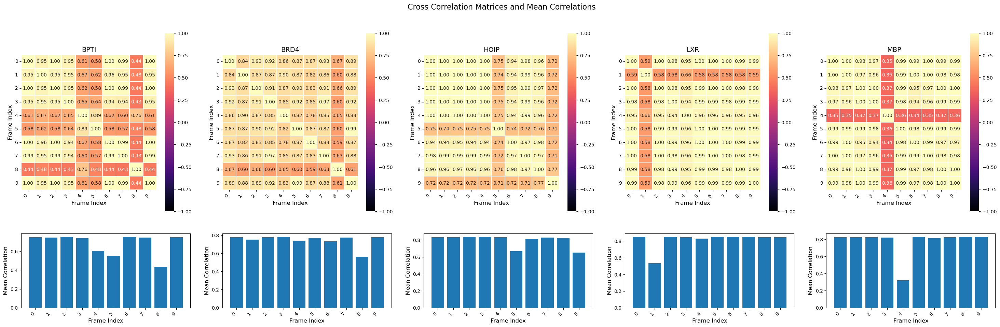

In [49]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj

def calc_intra_residue_cross_correlation(universe, frame_indexes, residues:list=None):
    """
    After aligning the trajectory in memory, calculate the cross correlation
    of the intra-residue distances between the specified frame indexes.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    ref = universe.select_atoms(sel)

    # Align the trajectory to the first frame
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(frame_indexes)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrices for the specified frames
    dist_matrices = []
    for frame_index in frame_indexes:
        universe.trajectory[frame_index]
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        dist_matrices.append(dist_matrix)

    # Calculate the cross correlation between the specified frames
    cross_correlation_matrix = np.zeros((n_frames, n_frames))
    for i in range(n_frames):
        for j in range(n_frames):
            cross_correlation_matrix[i, j] = pearsonr(dist_matrices[i].flatten(), dist_matrices[j].flatten())[0]

    return cross_correlation_matrix

# ... (rest of the code remains the same)

intra_residue_cross_correlation_df = pd.DataFrame()

for protein in protein_names:
    frame_indexes = all_masks_frames[protein]
      # Specify the frame indexes for cross correlation calculation
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    intra_residue_cross_correlation = calc_intra_residue_cross_correlation(universe, frame_indexes, residues=residues)
    df_to_add = pd.DataFrame({"protein": protein, "intra_residue_cross_correlation": [intra_residue_cross_correlation]})
    intra_residue_cross_correlation_df = pd.concat([intra_residue_cross_correlation_df, df_to_add], axis=0)

import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Create a single figure with subplots for each protein
n_proteins = len(protein_names)
fig, axes = plt.subplots(2, n_proteins, figsize=(6 * n_proteins, 10), gridspec_kw={'height_ratios': [3, 1]})

for i, protein in enumerate(protein_names):
    cross_correlation_matrix = intra_residue_cross_correlation_df[intra_residue_cross_correlation_df["protein"] == protein]["intra_residue_cross_correlation"].values[0]
    row_sum = np.sum(cross_correlation_matrix, axis=1)
    mean_rows = [(row - 1) / len(row_sum) for row in row_sum]

    # Plot the heatmap on the corresponding subplot
    sns.heatmap(cross_correlation_matrix, cmap="magma", vmin=-1, vmax=1, annot=True, fmt=".2f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=axes[0, i])

    # Set the title and labels for each heatmap subplot
    axes[0, i].set_title(f"{protein}", fontsize=14)
    axes[0, i].set_xlabel("Frame Index", fontsize=12)
    axes[0, i].set_ylabel("Frame Index", fontsize=12)

    # Rotate the x-tick labels for better readability
    axes[0, i].set_xticklabels(axes[0, i].get_xticklabels(), rotation=45, ha='right', fontsize=10)
    axes[0, i].set_yticklabels(axes[0, i].get_yticklabels(), rotation=0, fontsize=10)

    # Plot the mean row as a bar chart on the corresponding subplot
    axes[1, i].bar(range(len(mean_rows)), mean_rows)
    axes[1, i].set_xlabel("Frame Index", fontsize=12)
    axes[1, i].set_ylabel("Mean Correlation", fontsize=12)
    axes[1, i].set_xticks(range(len(mean_rows)))
    axes[1, i].set_xticklabels(range(len(mean_rows)), rotation=45, ha='right', fontsize=10)

# Adjust the spacing between subplots
plt.tight_layout(pad=3.0)

# Add a main title for the entire figure
fig.suptitle("Cross Correlation Matrices and Mean Correlations", fontsize=16)

# Display the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



9242.8996
4971.3994
8100.7564
5939.5292
4735.8564
4479.162600000001
8836.2274
9107.342200000001
4652.2146
8101.717799999999
4971.3994
2673.9241
4357.0846
3194.6438000000003
2547.2346
2409.1689
4752.6660999999995
4898.4883
2502.2469
4357.6017
8100.7564
4357.0846
7099.747600000001
5205.5828
4150.6476
3925.6734000000006
7744.3366000000005
7981.949800000001
4077.3414000000002
7100.590200000001
5939.5292
3194.6438000000003
5205.5828
3816.7684
3043.2828
2878.3302000000003
5678.1998
5852.419400000001
2989.5342
5206.2006
4735.8564
2547.2346
4150.6476
3043.2828
2426.5476
2295.0234
4527.486599999999
4666.3998
2383.6914
4151.1402
4479.162600000001
2409.1689
3925.6734000000006
2878.3302000000003
2295.0234
2170.6281000000004
4282.0869
4413.470700000001
2254.4901
3926.1393000000003
8836.2274
4752.6660999999995
7744.3366000000005
5678.1998
4527.486599999999
4282.0869
8447.4481
8706.6343
4447.524899999999
7745.2557
9107.342200000001
4898.4883
7981.949800000001
5852.419400000001
4666.3998
4413.47070000

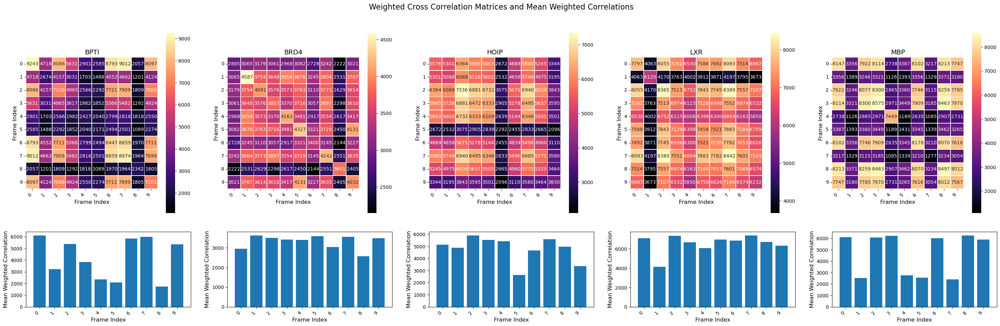

In [50]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj

def calc_weighted_intra_residue_cross_correlation(universe, frame_indexes, plddt_scores, residues:list=None):
    """
    After aligning the trajectory in memory, calculate the weighted cross correlation
    of the intra-residue distances between the specified frame indexes using pLDDT scores as weights.
    """
    sel = "protein and name CA"
    if residues is not None:
        resi_sel = " or ".join([f" resid {res}" for res in residues])
        sel = sel + f" and ({resi_sel})"

    ref = universe.select_atoms(sel)

    # Align the trajectory to the first frame
    alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

    n_frames = len(frame_indexes)
    n_residues = len(ref.residues)

    # Calculate the intra-residue distance matrices for the specified frames
    dist_matrices = []
    for frame_index in frame_indexes:
        universe.trajectory[frame_index]
        coords = ref.positions
        dist_matrix = squareform(pdist(coords))
        dist_matrices.append(dist_matrix)

    # Calculate the weighted cross correlation between the specified frames
    weighted_cross_correlation_matrix = np.zeros((n_frames, n_frames))
    for i in range(n_frames):
        for j in range(n_frames):
            weights = np.outer(plddt_scores[frame_indexes[i]], plddt_scores[frame_indexes[j]])[0][0]
            print(weights)
            weighted_cross_correlation_matrix[i, j] = float(weights)*pearsonr(dist_matrices[i].flatten(), dist_matrices[j].flatten())[0]

    return weighted_cross_correlation_matrix

# ... (rest of the code remains the same)

weighted_intra_residue_cross_correlation_df = pd.DataFrame()

for protein in protein_names:
    frame_indexes = all_masks_frames[protein]
    plddt = plddt_data[protein]
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    weighted_intra_residue_cross_correlation = calc_weighted_intra_residue_cross_correlation(universe, frame_indexes, plddt, residues=residues)
    df_to_add = pd.DataFrame({"protein": protein, "weighted_intra_residue_cross_correlation": [weighted_intra_residue_cross_correlation]})
    weighted_intra_residue_cross_correlation_df = pd.concat([weighted_intra_residue_cross_correlation_df, df_to_add], axis=0)

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Create a single figure with subplots for each protein
n_proteins = len(protein_names)
fig, axes = plt.subplots(2, n_proteins, figsize=(6 * n_proteins, 10), gridspec_kw={'height_ratios': [3, 1]})

for i, protein in enumerate(protein_names):
    weighted_cross_correlation_matrix = weighted_intra_residue_cross_correlation_df[weighted_intra_residue_cross_correlation_df["protein"] == protein]["weighted_intra_residue_cross_correlation"].values[0]
    row_sum = np.sum(weighted_cross_correlation_matrix, axis=1)
    mean_rows = [(row - 1) / len(row_sum) for row in row_sum]

    # Plot the heatmap on the corresponding subplot
    sns.heatmap(weighted_cross_correlation_matrix, cmap="magma", annot=True, fmt=".0f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=axes[0, i])

    # Set the title and labels for each heatmap subplot
    axes[0, i].set_title(f"{protein}", fontsize=14)
    axes[0, i].set_xlabel("Frame Index", fontsize=12)
    axes[0, i].set_ylabel("Frame Index", fontsize=12)

    # Rotate the x-tick labels for better readability
    axes[0, i].set_xticklabels(axes[0, i].get_xticklabels(), rotation=45, ha='right', fontsize=10)
    axes[0, i].set_yticklabels(axes[0, i].get_yticklabels(), rotation=0, fontsize=10)

    # Plot the mean row as a bar chart on the corresponding subplot
    axes[1, i].bar(range(len(mean_rows)), mean_rows)
    axes[1, i].set_xlabel("Frame Index", fontsize=12)
    axes[1, i].set_ylabel("Mean Weighted Correlation", fontsize=12)
    axes[1, i].set_xticks(range(len(mean_rows)))
    axes[1, i].set_xticklabels(range(len(mean_rows)), rotation=45, ha='right', fontsize=10)

# Adjust the spacing between subplots
plt.tight_layout(pad=3.0)

# Add a main title for the entire figure
fig.suptitle("Weighted Cross Correlation Matrices and Mean Weighted Correlations", fontsize=16)

# Display the plot
plt.show()

In [66]:
import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from MDAnalysis.analysis.align import AlignTraj
import seaborn as sns
import matplotlib.pyplot as plt
def calc_intra_residue_cross_correlation(universe, frame_indexes, residues):
        sel = "protein and name CA"
        if residues is not None:
            resi_sel = " or ".join([f" resid {res}" for res in residues])
            sel = sel + f" and ({resi_sel})"

        ref = universe.select_atoms(sel)

        alignment = AlignTraj(universe, ref, select=sel, in_memory=True).run()

        n_frames = len(frame_indexes)
        n_residues = len(ref.residues)

        dist_matrices = []
        for frame_index in frame_indexes:
            universe.trajectory[frame_index]
            coords = ref.positions
            dist_matrix = squareform(pdist(coords))
            dist_matrices.append(dist_matrix)

        cross_correlation_matrix = np.zeros((n_frames, n_frames))
        for i in range(n_frames):
            for j in range(n_frames):
                cross_correlation_matrix[i, j] = pearsonr(dist_matrices[i].flatten(), dist_matrices[j].flatten())[0]

        return cross_correlation_matrix


def calc_weighted_intra_residue_cross_correlation(cross_correlation_matrix, weights):
        n_frames = len(weights)
        dist_matrices = []


        weighted_cross_correlation_matrix = np.zeros((n_frames, n_frames))
        for i in range(n_frames):
            for j in range(n_frames):
                weights_ij = np.outer(weights[i], weights[j])[0][0]
                weighted_cross_correlation_matrix[i, j] = float(weights_ij) * pearsonr(cross_correlation_matrix[i].flatten(), cross_correlation_matrix[j].flatten())[0]

        return weighted_cross_correlation_matrix

def plot_cross_correlation_matrices(universe, weights, residues, frame_indexes, protein_name, save_dir=None):
    
    assert len(weights) == len(frame_indexes), "Number of weights must match the number of frame indexes"

    weights =  weights*(len(weights)/np.sum(weights))

    cross_correlation_matrix = calc_intra_residue_cross_correlation(universe, frame_indexes, residues)
    weighted_cross_correlation_matrix = calc_weighted_intra_residue_cross_correlation(cross_correlation_matrix, weights)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    sns.heatmap(cross_correlation_matrix, cmap="magma", vmin=-1, vmax=1, annot=True, fmt=".2f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=ax1)
    ax1.set_title(f"{protein_name} - Cross Correlation Matrix", fontsize=14)
    ax1.set_xlabel("Frame Index", fontsize=12)
    ax1.set_ylabel("Frame Index", fontsize=12)
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right', fontsize=10)
    ax1.set_yticklabels(ax1.get_yticklabels(), rotation=0, fontsize=10)

    sns.heatmap(weighted_cross_correlation_matrix, cmap="magma", annot=True, fmt=".2f", square=True,
                linewidths=0.5, cbar_kws={"shrink": 0.8}, ax=ax2)
    ax2.set_title(f"{protein_name} - Weighted Cross Correlation Matrix", fontsize=14)
    ax2.set_xlabel("Frame Index", fontsize=12)
    ax2.set_ylabel("Frame Index", fontsize=12)
    ax2.set_xticklabels(ax2.get_xticklabels(), rotation=45, ha='right', fontsize=10)
    ax2.set_yticklabels(ax2.get_yticklabels(), rotation=0, fontsize=10)

    plt.tight_layout()
    if save_dir is not None:
        plt.savefig(f"{save_dir}/{protein_name}_cross_correlation_matrices.png")
    else:
        plt.show()

SyntaxError: invalid syntax (3889541149.py, line 78)

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



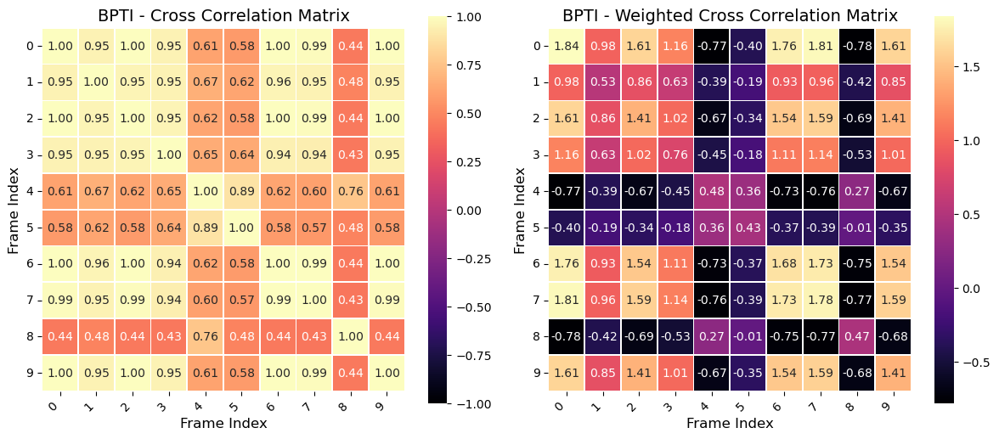

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



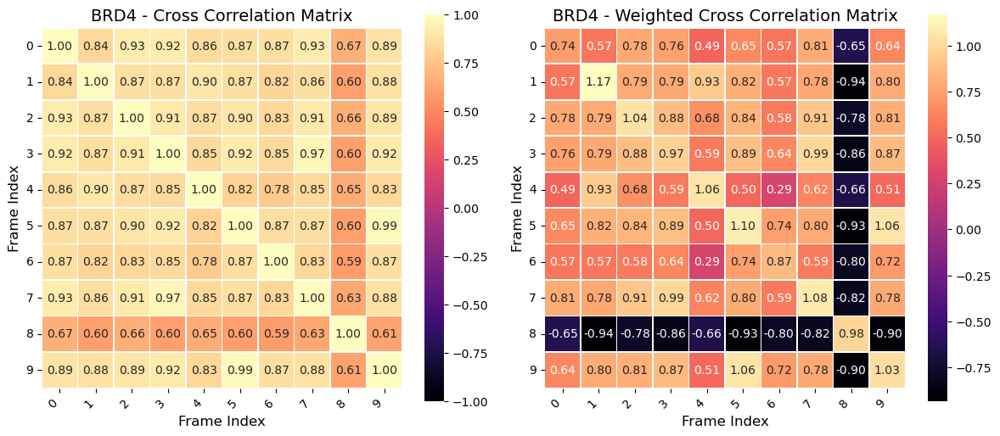

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



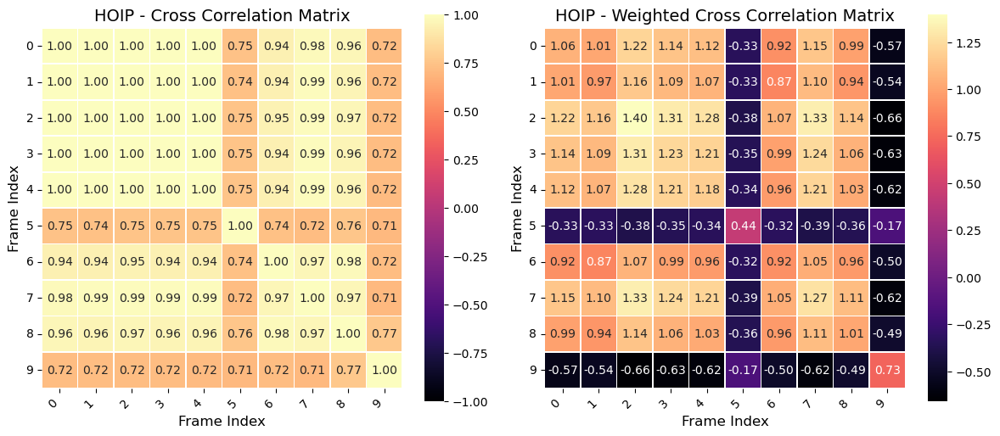

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



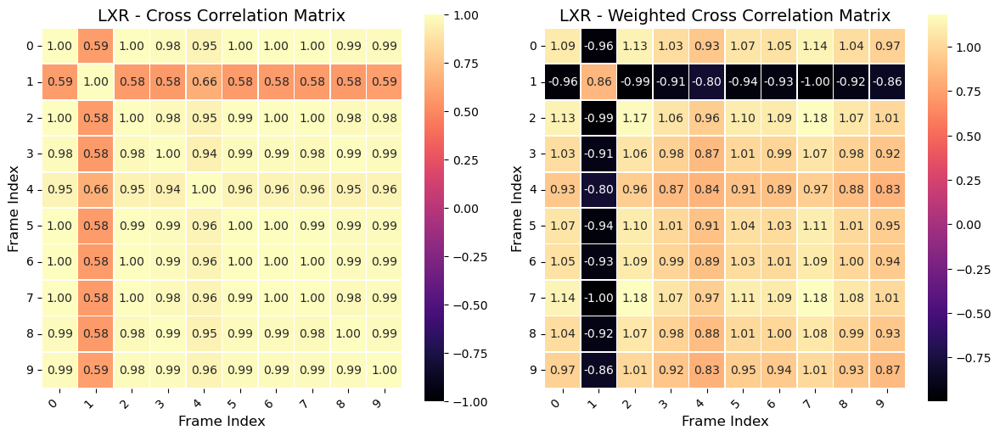

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:300: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:301: RuntimeWarning:

invalid value encountered in scalar divide

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/MDAnalysis/lib/mdamath.py:302: RuntimeWarning:

invalid value encountered in scalar divide



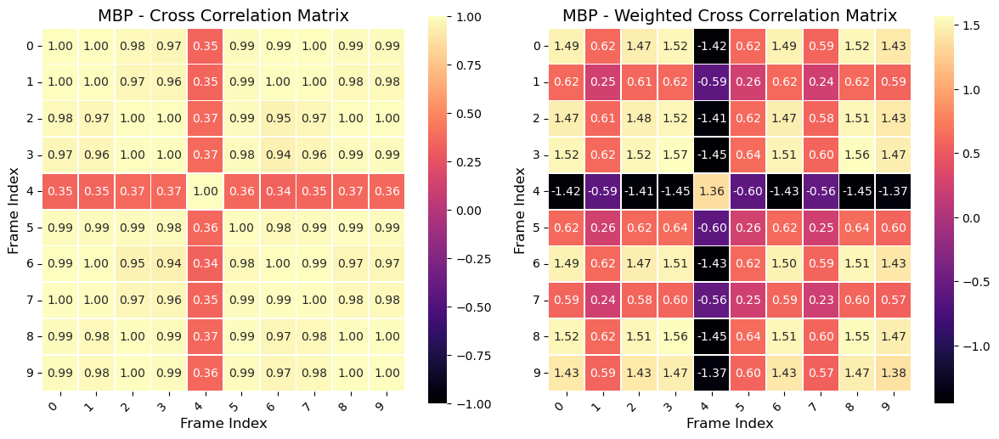

In [65]:
for protein in protein_names:
    frame_indexes = all_masks_frames[protein]
    weights = plddt_data[protein]
    residues = res_data[protein]
    universe = mda.Universe(proteins[protein]["top"], proteins[protein]["traj"])
    weights = weights[frame_indexes]
    plot_cross_correlation_matrices(universe, weights, residues, frame_indexes, protein)

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_and(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    min_dist =  np.percentile(masked_intra_residue_dists,cov_thresholds[i][0])
    max_dist = np.percentile(masked_intra_residue_dists,cov_thresholds[i][1])
    
    min_dist_mask = (masked_intra_residue_dists > min_dist)
    max_dist_mask = (masked_intra_residue_dists < max_dist)


    dist_mask = np.logical_and(min_dist_mask,max_dist_mask)

    dist_con_cov_mask = np.logical_or(dist_mask,con_cov_mask)


    # mask_indexes = np.where(labels == 1)[0]
    # print(mask_indexes.shape)
    trace = go.Scatter(
        x=pca1[combined_mask][:],
        y=pca2[combined_mask][:],
        mode='markers',
        marker=dict(
            size=6,
            color=intra_residue_dists[combined_mask][:],
            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='ptm',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_trace = go.Scatter(
        x=[pca1[ref_index]],
        y=[pca2[ref_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[pca1[max_plddt_index]],
        y=[pca2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create a 3D plot for each protein
fig = make_subplots(
    rows=len(protein_names), cols=1,
    specs=[[{'type': 'scatter'}] for _ in range(len(protein_names))],  # Changed 'scene' to 'scatter'
    subplot_titles=protein_names,
    vertical_spacing=0.05
)

con_thresholds = [(0.1,99.95),(1,99),(0.5,99.4),(1.5,99.9),(1,99.4)]
cov_thresholds = [(0.1,99.9),(1,99.8),(0.5,99.9),(1.5,99.9),(1.5,99.9)]
conf_thresholds = [(1,99.95),(2.5,99),(2,99.4),(1.25,99.9),(5,99.4)]


for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    c = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]
    covariance = intra_residue_covariance_df[intra_residue_covariance_df["protein"] == protein]["intra_residue_covariance"].values[0]
    pca = pca_df[pca_df["protein"]==protein]["pca"].values[0]
    pca1 = pca[:,0]
    pca2 = pca[:,1]
    

   
    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    


    # labels = []    
    # for idx, pt in enumerate(ptm):
    #     pl = plddt[idx]
    #     con = contact_order[idx]
    #     cov = covariance[idx]

    #     if (pl < plddt_threshold and pt < ptm_threshold):
    #         label = 0
    #     elif (con < min_con) or (con > max_con):
    #         label = 0
    #     elif(cov < min_cov):
    #         label = 0
    #     # elif pt < ptm_threshold:
    #     #     label = 0.4
    #     else:
    #         label = 1
     
    #     labels.append(label)
    # labels = np.array(labels)

    plddt_threshold = np.percentile(plddt,conf_thresholds[i][0])
    ptm_threshold =  np.percentile(ptm,conf_thresholds[i][0])
    
        # Create a mask for plddt values below the threshold
    plddt_mask = (plddt > plddt_threshold)

    # Create a mask for ptm values below the threshold
    ptm_mask = (ptm > ptm_threshold)

    # Combine the masks using logical o
    combined_mask = np.logical_or(plddt_mask,ptm_mask)

    masked_contact_order = contact_order[combined_mask]
    masked_covariance = covariance[combined_mask]
    masked_intra_residue_dists = intra_residue_dists[combined_mask]
    # masked_pca = pca[combined_mask]

    max_cov = np.percentile(covariance,100)
    mean_cov = np.mean(covariance)

    min_cov = np.percentile(covariance,1)
    # print(max_cov)
    # print(min_cov)
    cov_threshold = np.percentile(masked_covariance,cov_thresholds[i][0])

    median_con = np.median(masked_contact_order)
    mean_con = np.mean(masked_contact_order)
    max_con = np.percentile(masked_contact_order, con_thresholds[i][1])
    mean_con = np.mean(masked_contact_order)

    min_con = np.percentile(masked_contact_order,con_thresholds[i][0])

    min_con_mask = (masked_contact_order > min_con)
    max_con_mask = (masked_contact_order < max_con)

    con_mask = np.logical_or(min_con_mask,max_con_mask)

    cov_mask = (masked_covariance > cov_threshold)

    con_cov_mask = np.logical_or(con_mask,cov_mask)


    mask_indexes = np.where(labels == 1)[0]
    print(mask_indexes.shape)
    trace = go.Scatter(
        x=pca1[combined_mask][con_cov_mask],
        y=pca2[combined_mask][con_cov_mask],
        mode='markers',
        marker=dict(
            size=6,
            color=intra_residue_dists[combined_mask][con_cov_mask],
            colorscale='Viridis',
            opacity=0.5,
            colorbar=dict(  # Added colorbar
                title='ptm',
                len=0.8,
                thickness=20,
                # tickvals=[0, 0.75, 0.4, 1],
                # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
            )
        ),
        name=protein,
        hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )

    fig.add_trace(trace, row=i+1, col=1)
    
    ref_index = 1 if protein == "BRD4" else 0
    ref_trace = go.Scatter(
        x=[pca1[ref_index]],
        y=[pca2[ref_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='black',
            symbol='square'
        ),
        name='Reference',
        hovertemplate='Reference<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(ref_trace, row=i+1, col=1)
    
    # Plot the maximum pLDDT index as a red dot
    max_plddt_index = np.argmax(plddt)
    max_plddt_trace = go.Scatter(
        x=[pca1[max_plddt_index]],
        y=[pca2[max_plddt_index]],
        mode='markers',
        marker=dict(
            size=10,
            color='red',
            symbol='star'
        ),
        name='Max pLDDT',
        hovertemplate='Max pLDDT<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    )
    fig.add_trace(max_plddt_trace, row=i+1, col=1)
    
    # trace = go.Scatter(
    #     x=pca1[~mask_indexes],
    #     y=pca2[~mask_indexes],
    #     mode='markers',
    #     marker=dict(
    #         size=5,
    #         color='Grey',
    #         # colorscale='Grey',
    #         opacity=0.1,
    #         colorbar=dict(  # Added colorbar
    #             title='ptm',
    #             len=0.8,
    #             thickness=20,
    #             # tickvals=[0, 0.75, 0.4, 1],
    #             # ticktext=['Bad pLDDT & PTM', 'Low Covariance', 'Bad Contacts', 'Passed']
    #         )
    #     ),
    #     name=protein,
    #     hovertemplate='Element: %{pointNumber}<br>PCA1: %{x:.2f}<br>PCA2: %{y:.2f}<extra></extra>'
    # )

    # fig.add_trace(trace, row=i+1, col=1)
    
    fig.update_xaxes(title_text='PCA1', row=i+1, col=1)  # Updated axis title
    fig.update_yaxes(title_text='PCA2', row=i+1, col=1)  # Updated axis title

fig.update_layout(
    height=300 * len(protein_names),
    width=800,
    title_text='2D Scatter Plot of PCA1 and PCA2',
    showlegend=False
)

fig.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Create a 3D plot for each protein
fig = plt.figure(figsize=(12, 20))

for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]

    ax = fig.add_subplot(len(protein_names), 1, i+1, projection='3d')
    
    # Create a scatter plot
    sc = ax.scatter(rmsd, intra_residue_dists, contact_order, c=plddt, cmap='viridis', alpha=0.2, s=10)

    # plot the 0th index as a black point
    ax.scatter(rmsd[0], intra_residue_dists[0], contact_order[0], c='black')


    
    # Set labels and title
    ax.set_xlabel('RMSD')
    ax.set_ylabel('Intra-Residue Distance')
    ax.set_zlabel('contact_order')
    ax.set_title(protein)
    
    # Add a colorbar
    cbar = fig.colorbar(sc, ax=ax, shrink=0.6)
    cbar.set_label('pLDDT')

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Create a 3D plot for each protein
fig = plt.figure(figsize=(12, 20))

for i, protein in enumerate(protein_names):
    intra_residue_dists = intra_residue_dist_df[intra_residue_dist_df["protein"]==protein]["intra_residue_dist"].values[0]
    rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
    plddt = plddt_data[protein]
    max_pae = max_pae_data[protein]
    ptm = ptm_data[protein]
    contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]


    ax = fig.add_subplot(len(protein_names), 1, i+1, projection='3d')
    
    # Create a scatter plot
    sc = ax.scatter(rmsd, intra_residue_dists, contact_order, c=plddt, cmap='viridis', alpha=0.5, s=10)

    # plot the 0th index as a black point
    ax.scatter(rmsd[0], intra_residue_dists[0], contact_order[0], c='black', s=50)


    
    # Set labels and title
    ax.set_xlabel('RMSD')
    ax.set_ylabel('Intra-Residue Distance')
    ax.set_zlabel('contact_order')
    ax.set_title(protein)
    
    # Add a colorbar
    cbar = fig.colorbar(sc, ax=ax, shrink=0.6)
    cbar.set_label('plddt')

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# plot RMSD for each protein as a histogram

fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

for i, protein in enumerate(protein_names):
    contact_order = contact_order_df[contact_order_df["protein"] == protein]["contact_order"].values[0]

    sns.scatterplot(x=plddt_data[protein], y=RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0], ax=ax[i], c=contact_order, cmap="viridis")
    ax[i].set_title(protein)
    ax[i].set_xlabel("plddt")
    ax[i].set_ylabel("RMSD")

plt.tight_layout()

plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# plot RMSD for each protein as a histogram

fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

for i, protein in enumerate(protein_names):

    pca_

    sns.scatterplot(x=plddt_data[protein], y=RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0], ax=ax[i], c=plddt_data[protein], cmap="viridis")
    ax[i].set_title(protein)
    ax[i].set_xlabel("plddt")
    ax[i].set_ylabel("RMSD")

plt.tight_layout()

plt.show()

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot RMSD for each protein as a histogram - scaled by their plddt from the json file

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

# for i, protein in enumerate(protein_names):

#     plddt = plddt_data[protein]
#     print(plddt.shape)
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     rmsd = np.array(rmsd)
#     print(rmsd.shape)
#     # plddt = plddt / plddt.sum()
#     sns.histplot(x=plddt, bins=50, ax=ax[i])
#     # sns.histplot(rmsd, bins=50, ax=ax[i], weights=weights, stat='density')
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Scaled RMSD")
#     ax[i].set_ylabel("Count")

# plt.tight_layout()

# plt.yscale("log")

# plt.show()

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot RMSD for each protein as a histogram - scaled by their plddt from the json file

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

# for i, protein in enumerate(protein_names):

#     plddt = plddt_data[protein]
#     print(plddt.shape)
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     rmsd = np.array(rmsd)
#     print(rmsd.shape)
#     # plddt = plddt / plddt.sum()
#     sns.histplot(x=rmsd, bins=50, ax=ax[i], weights=1/plddt, stat='density')

#     # sns.histplot(rmsd, bins=50, ax=ax[i], weights=weights, stat='density')
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Scaled RMSD")
#     ax[i].set_ylabel("Count")
#     ax[i].set_yscale("log")

# plt.tight_layout()


# plt.show()

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns


# # plot RMSD for each protein as a histogram - scaled by their plddt from the json file

# fig, ax = plt.subplots(len(protein_names), 1, figsize=(10, 20))

# for i, protein in enumerate(protein_names):

#     plddt = plddt_data[protein]
#     print(plddt.shape)
#     rmsd = RMSD_df[RMSD_df["protein"] == protein]["RMSD"].values[0]
#     rmsd = np.array(rmsd)
#     print(rmsd.shape)
#     weights = plddt / plddt.sum()
#     sns.histplot(x=rmsd, bins=50, ax=ax[i], weights=plddt)

#     # sns.histplot(rmsd, bins=50, ax=ax[i], weights=weights, stat='density')
#     ax[i].set_title(protein)
#     ax[i].set_xlabel("Scaled RMSD")
#     ax[i].set_ylabel("Count")

# plt.tight_layout()

# plt.yscale("log")

# plt.show()

In [ ]:
# write out trajectories using filters
# first do low plddt and ptm
# then filter out bad contacts and low covariance



In [ ]:
# cluster down to 10 frames - plot heatmap of the clusters with various filters
